In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pprint
sns.set(style="white", context='poster')
import math

In [2]:
%load_ext autoreload
%autoreload 2


In [3]:
from model_equations_separate_NC_store_numba import *

In [4]:
pro99_mode=False
which_organism = 'all'
(var_names, init_var_vals, intermediate_names, calc_dydt, prepare_params_tuple
        ) = get_constants_per_organism(pro99_mode, which_organism)


In [5]:

list(zip(var_names, init_var_vals))

[('Bp', 0.892857142857143),
 ('Np', 0.0),
 ('Cp', 0.0),
 ('Bh', 28.571428571428573),
 ('Nh', 0.0),
 ('Ch', 0.0),
 ('DON', 3.0),
 ('RDON', 0.0),
 ('DIN', 100.0),
 ('DOC', 19.875),
 ('RDOC', 0.0),
 ('DIC', 2241.552301207755),
 ('ROS', 0.2)]

In [6]:
init_var_vals[0], init_var_vals[3]

(0.892857142857143, 28.571428571428573)

In [7]:
morder = ['MIN', 'OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS',]
media_order = ['lowN', 'pro99']
mpalette = 'twilight'
sns.color_palette(mpalette, n_colors=5)


[(0.4828677867260272, 0.6304330455306234, 0.761915371498953),
 (0.3668108554010799, 0.26404857724525643, 0.6464799165290824),
 (0.18488035509396164, 0.07942573027972388, 0.21307651648984993),
 (0.5566322903496934, 0.17269677158182117, 0.31423043195101424),
 (0.775907907306857, 0.5355421788246119, 0.42413367909988375)]

In [8]:

HCOLOR = '#ffc58f'
HCOLOR_light = '#ffd2a9'
PCOLOR = '#99cc99'
PCOLOR_light = '#aad5aa'

DONCOLOR = '#7285b7'
RDONCOLOR = 'black' #'#00334D'
DINCOLOR = '#bbdaff' #'#000066'

DOCCOLOR = '#cc6666'
RDOCCOLOR = 'black' #'#00334D'
DICCOLOR = '#ff9da4' #'#000066'

SHCOLOR = '#ffa98f'
SPCOLOR = '#326232'


ccnpalette = [PCOLOR, HCOLOR, SPCOLOR, SHCOLOR,DONCOLOR, RDONCOLOR, DINCOLOR]
ccnorder = ['Bp', 'Bh', 'Sp', 'Sh', 'DON', 'RDON', 'DIN', ]
cccpalette = [PCOLOR, HCOLOR, SPCOLOR, SHCOLOR, DOCCOLOR, RDOCCOLOR, DICCOLOR]
cccorder = ['Bp[C]', 'Bh[C]', 'Sp[C]', 'Sh[C]', 'DOC', 'RDOC', 'DIC']
ccxpalette = [PCOLOR, HCOLOR]
ccxorder = ['Xp', 'Xh']
hnpalette = [ HCOLOR_light, SPCOLOR, SHCOLOR, DONCOLOR, RDONCOLOR, DINCOLOR]
hnorder = [ 'Bh', 'Sp', 'Sh', 'DON', 'RDON', 'DIN']
hcpalette = [ HCOLOR_light, SPCOLOR, SHCOLOR, DOCCOLOR, RDOCCOLOR, DICCOLOR]
hcorder = [ 'Bh[C]', 'Sp[C]', 'Sh[C]', 'DOC', 'RDOC', 'DIC']
pnpalette = [ PCOLOR_light, SPCOLOR, SHCOLOR, DONCOLOR, RDONCOLOR, DINCOLOR]
pnorder = [ 'Bp', 'ABp', 'ABh', 'DON', 'RDON', 'DIN']
pcpalette = [ PCOLOR_light, SPCOLOR, SHCOLOR, DOCCOLOR, RDOCCOLOR, DICCOLOR]
pcorder = [ 'Bp[C]', 'Sp[C]', 'Sh[C]', 'DOC', 'RDOC', 'DIC']
sns.color_palette(ccnpalette + cccpalette, )
# 


[(0.6, 0.8, 0.6),
 (1.0, 0.7725490196078432, 0.5607843137254902),
 (0.19607843137254902, 0.3843137254901961, 0.19607843137254902),
 (1.0, 0.6627450980392157, 0.5607843137254902),
 (0.4470588235294118, 0.5215686274509804, 0.7176470588235294),
 (0.0, 0.0, 0.0),
 (0.7333333333333333, 0.8549019607843137, 1.0),
 (0.6, 0.8, 0.6),
 (1.0, 0.7725490196078432, 0.5607843137254902),
 (0.19607843137254902, 0.3843137254901961, 0.19607843137254902),
 (1.0, 0.6627450980392157, 0.5607843137254902),
 (0.8, 0.4, 0.4),
 (0.0, 0.0, 0.0),
 (1.0, 0.615686274509804, 0.6431372549019608)]

In [9]:
refdf = pd.read_excel('reference_10cc_axenic.xlsx')
refp99df = pd.read_excel('reference_pro99_axenic.xlsx')


In [69]:
dpath = r'C:\Users\oweisberg\OneDrive - University of Haifa\Documents\results\recycle_model\res\29062023'
dpath = r'C:\Users\Osnat\OneDrive - University of Haifa\Documents\results\recycle_model\res\29062023'
dpath = 'results'

os.listdir(dpath)

['sensitivity_vmax2_df.csv.gz',
 'sensitivity_df.csv.gz',
 'default_initial_lowN_ponly_MIN_h4139617574487472499_sum.csv.gz',
 'monte_ponly_df.csv.gz',
 'default_initial_lowN_ponly_MIN_h4139617574487472499_mse.csv.gz',
 'default_initial_lowN_ponly_MIN_h4139617574487472499_df.csv.gz',
 'baseline_df.csv.gz',
 'results_old_26122023',
 'monte_het_clean_sum.csv.gz',
 'baseline_sum.csv.gz',
 'sensitivity_vmax2_sum.csv.gz',
 'sensitivity_vmax_mse.csv.gz',
 'monte_ponly_mse.csv.gz',
 'monte_ponly_sum.csv.gz',
 'monte_het_clean_mse.csv.gz',
 'sensitivity_sum.csv.gz',
 'sensitivity_vmax2_mse.csv.gz',
 'sensitivity_vmax_df.csv.gz',
 'monte_het_mse.csv.gz',
 'monte_het_sum.csv.gz',
 'sensitivity_mse.csv.gz',
 'monte_het_df.csv.gz',
 'sensitivity_vmax_sum.csv.gz',
 'baseline_mse.csv.gz',
 'monte_het_clean_df.csv.gz']

In [70]:
init_bdf = pd.read_csv(os.path.join(dpath,'default_initial_lowN_ponly_MIN_h4139617574487472499_df.csv.gz' ))


In [11]:
sum_sdf = pd.read_csv(os.path.join(dpath,'sensitivity_sum.csv.gz' ))
sdf =  pd.read_csv(os.path.join(dpath,'sensitivity_df.csv.gz' ))
mse_sdf = pd.read_csv(os.path.join(dpath,'sensitivity_mse.csv.gz' ))

In [12]:
sum_bdf = pd.read_csv(os.path.join(dpath,'baseline_sum.csv.gz' ))
bdf =  pd.read_csv(os.path.join(dpath,'baseline_df.csv.gz' ))
mse_bdf = pd.read_csv(os.path.join(dpath,'baseline_mse.csv.gz' ))

In [13]:
def _params_from_runid_sen(x):
    
    df = x.str.replace(r'_h-*[0-9]+', '', regex=True
         ).str.replace('sensitivity_vmax_', '', regex=False
         ).str.replace('sensitivity_', '', regex=False
         ).str.replace('baseline_', 'p_1_0_', regex=False
         ).str.rsplit('_', expand=True,n=5)
    df.rename(columns={0:'param', 2:'paramval', 3:'media', 4: 'mode', 5:'model'}, inplace=True)
    df['run_id'] = x
    
    df.loc[df.param.isin(['p']), ['run', ]] = 'base'
    df['run'] = 'sensitivity'
    df.loc[df.param.isin(['p']), ['param', 'paramval', ]] = np.NaN
    return df[['media', 'mode', 'model', 'run', 'run_id', 'param', 'paramval', ]]

senparams = _params_from_runid_sen(sum_sdf.run_id)
senparams
sdf = pd.merge(sdf, senparams, on='run_id', how='left')
#mse_df = pd.merge(mse_df, senparams, on='run_id', how='left')
#sum_df = pd.merge(sum_df, senparams, on='run_id', how='left')


In [14]:
bparams = _params_from_runid_sen(sum_bdf.run_id)
bparams['run'] = 'baseline'
bparams
bdf = pd.merge(bdf, bparams, on='run_id', how='left')


# sensitivity dfs

In [15]:
bdf.columns

Index(['Bp', 'Np', 'Cp', 'Bh', 'Nh', 'Ch', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC',
       'DIC', 'ROS', 't', 'day', 'gross_uptakeINp', 'gross_uptakeINh',
       'gross_uptakeONp', 'gross_uptakeONh', 'gross_uptakeICp',
       'gross_uptakeICh', 'gross_uptakeOCp', 'gross_uptakeOCh', 'uptakeNp',
       'uptakeNh', 'uptakeCp', 'uptakeCh', 'QCp', 'QCh', 'biosynthesisNp',
       'biosynthesisNh', 'respirationCp', 'respirationCh',
       'biomass_breakdownCp', 'biomass_breakdownCh', 'overflowNp',
       'overflowNh', 'overflowCp', 'overflowCh', 'Bp[C]', 'Bptotal[N]',
       'Bptotal[C]', 'Bh[C]', 'Bhtotal[N]', 'Bhtotal[C]', 'run_id', 'media',
       'mode', 'model', 'run', 'param', 'paramval'],
      dtype='object')

In [16]:
params_list = senparams['param'].dropna().unique()

In [17]:
negative_ids = sdf.loc[sdf[var_names].min(axis=1) < -1e-6, 'run_id' ] 
negative_ids

Series([], Name: run_id, dtype: object)

In [18]:
negative_idsb = bdf.loc[bdf[var_names].min(axis=1) < -1e-6, 'run_id' ] 
negative_idsb

Series([], Name: run_id, dtype: object)

In [19]:
sdf = sdf.loc[~sdf.run_id.isin(negative_ids)]

In [20]:
bdf[var_names].min()

Bp      2.445371e-01
Np      0.000000e+00
Cp      0.000000e+00
Bh      8.330747e-01
Nh      0.000000e+00
Ch     -1.761184e-20
DON     9.693185e-01
RDON    0.000000e+00
DIN     5.121882e-05
DOC     1.470754e-03
RDOC    0.000000e+00
DIC     2.773747e+02
ROS     7.404713e-04
dtype: float64

In [21]:
sdf.columns

Index(['Bp', 'Np', 'Cp', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC', 'DIC', 'ROS',
       't', 'day', 'gross_uptakeINp', 'gross_uptakeONp', 'gross_uptakeICp',
       'gross_uptakeOCp', 'uptakeNp', 'uptakeCp', 'QCp', 'biosynthesisNp',
       'respirationCp', 'biomass_breakdownCp', 'overflowNp', 'overflowCp',
       'Bp[C]', 'Bptotal[N]', 'Bptotal[C]', 'run_id', 'Bh', 'Nh', 'Ch',
       'gross_uptakeINh', 'gross_uptakeONh', 'gross_uptakeICh',
       'gross_uptakeOCh', 'uptakeNh', 'uptakeCh', 'QCh', 'biosynthesisNh',
       'respirationCh', 'biomass_breakdownCh', 'overflowNh', 'overflowCh',
       'Bh[C]', 'Bhtotal[N]', 'Bhtotal[C]', 'media', 'mode', 'model', 'run',
       'param', 'paramval'],
      dtype='object')

In [22]:
sdf.dtypes

Bp                     float64
Np                     float64
Cp                     float64
DON                    float64
RDON                   float64
DIN                    float64
DOC                    float64
RDOC                   float64
DIC                    float64
ROS                    float64
t                      float64
day                    float64
gross_uptakeINp        float64
gross_uptakeONp        float64
gross_uptakeICp        float64
gross_uptakeOCp        float64
uptakeNp               float64
uptakeCp               float64
QCp                    float64
biosynthesisNp         float64
respirationCp          float64
biomass_breakdownCp    float64
overflowNp             float64
overflowCp             float64
Bp[C]                  float64
Bptotal[N]             float64
Bptotal[C]             float64
run_id                  object
Bh                     float64
Nh                     float64
Ch                     float64
gross_uptakeINh        float64
gross_up

In [23]:
sdf['paramval'] = pd.to_numeric(sdf['paramval'])

In [24]:
morder

['MIN', 'OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS']

In [25]:
model = 'MIN'
min_pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, 'PRO')
min_het_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, 'HET')
pvals = get_param_vals(model)
sdf['defaultval'] = sdf.param.map(pvals)    
for model in ['OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, 'PRO')
    het_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, 'HET')
    final_params_to_update = (
        (set(pro_params_to_update) | set(het_params_to_update))  - 
        (set(min_pro_params_to_update) | set(min_het_params_to_update)) 
    )

    pvals = get_param_vals(model)
    mask = sdf.param.isin(final_params_to_update)
    sdf.loc[mask, 'defaultval'] = sdf.loc[mask, 'param'].map(pvals)    


In [26]:
sdf['paramfc'] = np.log2(sdf.paramval / sdf.defaultval)

In [27]:
sdf.head()

,Bp,Np,Cp,DON,RDON,DIN,DOC,RDOC,DIC,ROS,...,Bhtotal[N],Bhtotal[C],media,mode,model,run,param,paramval,defaultval,paramfc
0,0.892857,0.000000,0.000000,3.000000,0.000000,100.000000,19.875000,0.000000,2241.552301,0.2,...,NaN,NaN,lowN,ponly,MIN,sensitivity,VmaxICp,0.000021,0.000006,1.923222
1,1.043100,0.115979,2.084760,3.081536,0.022028,99.630215,20.532218,0.164304,2237.876311,0.2,...,NaN,NaN,lowN,ponly,MIN,sensitivity,VmaxICp,0.000021,0.000006,1.923222
2,1.361805,0.157632,2.874267,3.190026,0.050846,99.132547,21.432548,0.389387,2234.458132,0.2,...,NaN,NaN,lowN,ponly,MIN,sensitivity,VmaxICp,0.000021,0.000006,1.923222
3,1.575709,0.182686,3.334610,3.262523,0.069910,98.802028,22.029761,0.538690,2232.332784,0.2,...,NaN,NaN,lowN,ponly,MIN,sensitivity,VmaxICp,0.000021,0.000006,1.923222
4,2.028223,0.235247,4.295282,3.416940,0.110194,98.102253,23.292073,0.854268,2227.994293,0.2,...,NaN,NaN,lowN,ponly,MIN,sensitivity,VmaxICp,0.000021,0.000006,1.923222


In [28]:
bdf

,Bp,Np,Cp,Bh,Nh,Ch,DON,RDON,DIN,DOC,...,Bh[C],Bhtotal[N],Bhtotal[C],run_id,media,mode,model,run,param,paramval
0,0.892857,0.000000,0.000000,28.571429,0.000000,0.000000e+00,3.000000,0.000000,100.000000,19.875000,...,142.857143,28.571429,142.857143,baseline_lowN_all_OVERFLOW_h6878164821315599434,lowN,all,OVERFLOW,baseline,NaN,NaN
1,0.876414,0.165690,0.247148,26.322268,9.009397,8.549844e-21,2.484961,0.812533,92.793023,0.001474,...,131.611339,35.331665,131.611339,baseline_lowN_all_OVERFLOW_h6878164821315599434,lowN,all,OVERFLOW,baseline,NaN,NaN
2,0.918969,0.221997,0.308357,21.294497,10.411813,2.041451e-21,5.471270,1.561278,92.584462,0.001494,...,106.472484,31.706310,106.472484,baseline_lowN_all_OVERFLOW_h6878164821315599434,lowN,all,OVERFLOW,baseline,NaN,NaN
3,0.949232,0.239439,0.327621,19.009474,10.902289,8.088425e-21,6.953960,1.933763,92.476130,0.001508,...,95.047370,29.911763,95.047370,baseline_lowN_all_OVERFLOW_h6878164821315599434,lowN,all,OVERFLOW,baseline,NaN,NaN
4,1.007770,0.262243,0.354823,15.641665,11.404828,5.615919e-21,9.328766,2.531573,92.287441,0.001537,...,78.208327,27.046493,78.208327,baseline_lowN_all_OVERFLOW_h6878164821315599434,lowN,all,OVERFLOW,baseline,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1105,1.751297,0.063240,0.329257,NaN,NaN,NaN,80.342559,21.727412,0.008349,575.838998,...,NaN,NaN,NaN,baseline_lowN_ponly_OVERFLOW_h6878164821315599434,lowN,ponly,OVERFLOW,baseline,NaN,NaN
1106,1.653874,0.079033,0.328164,NaN,NaN,NaN,80.249594,21.900986,0.009371,580.381411,...,NaN,NaN,NaN,baseline_lowN_ponly_OVERFLOW_h6878164821315599434,lowN,ponly,OVERFLOW,baseline,NaN,NaN
1107,1.613963,0.085739,0.327850,NaN,NaN,NaN,80.181335,22.001961,0.009859,583.005725,...,NaN,NaN,NaN,baseline_lowN_ponly_OVERFLOW_h6878164821315599434,lowN,ponly,OVERFLOW,baseline,NaN,NaN
1108,1.583480,0.090857,0.327564,NaN,NaN,NaN,80.105489,22.102770,0.010261,585.615440,...,NaN,NaN,NaN,baseline_lowN_ponly_OVERFLOW_h6878164821315599434,lowN,ponly,OVERFLOW,baseline,NaN,NaN


In [29]:
sdf.groupby(['mode', 'media']).size()

mode   media
all    lowN     122840
ponly  lowN      56240
       pro99     56240
dtype: int64

In [30]:
bdf['mode/media'] = bdf['mode']
bdf.loc[bdf.media.isin(['pro99']), 'mode/media'] = 'ponly/pro99'


In [31]:
sdf['mode/media'] = sdf['mode']
sdf.loc[sdf.media.isin(['pro99']), 'mode/media'] = 'ponly/pro99'


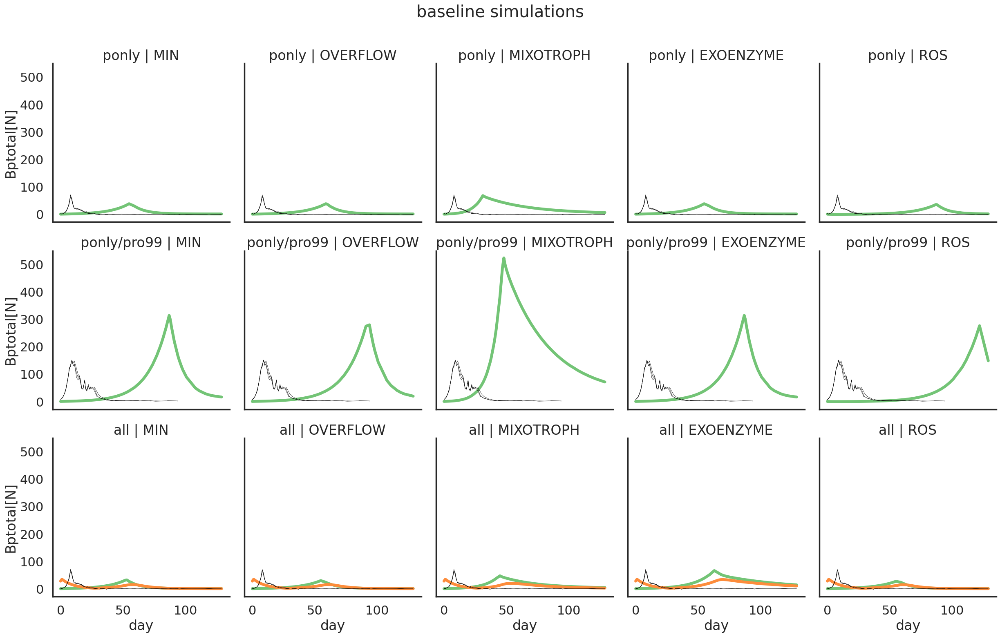

In [32]:

import matplotlib.colors as colors

curdf = bdf

g = sns.relplot(
    data=curdf, x='day', y='Bptotal[N]',
    units='run_id', estimator=None,
     kind='line', #hue_norm=colors.LogNorm(),
    row='mode/media', lw=5, legend=False, palette='Greens',
    row_order=['ponly', 'ponly/pro99', 'all'],
    col='model', col_order=morder, hue='run',

)
for (row_val, col_val), ax in g.axes_dict.items():
    if row_val == 'all':
        sns.lineplot(
            data=curdf.loc[curdf['mode'].isin(['all']) &
                           curdf.model.isin([col_val])
                          ], 
            x='day', y='Bhtotal[N]',
            units='run_id', estimator=None,
             #hue_norm=colors.LogNorm(),
             lw=5, legend=False, palette='Oranges',hue='run',
             ax=ax,
        )
    
    datadf = refdf 
    if row_val == 'ponly/pro99':
        datadf = refp99df
    sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
    units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                 legend=False
                )
g.set_titles(col_template='{col_name}', row_template='{row_name}')
plt.suptitle(f'baseline simulations', y=1.05)
plt.show()


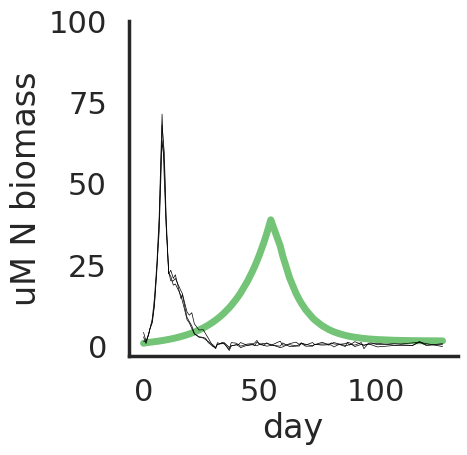

In [82]:

import matplotlib.colors as colors

curdf = bdf.loc[bdf.model.isin(['MIN']) & bdf.media.isin(['lowN']) & bdf['mode'].isin(['ponly'])]


g = sns.relplot(
    data=curdf, x='day', y='Bptotal[N]',
    units='run_id', estimator=None,
     kind='line', #hue_norm=colors.LogNorm(),
     lw=5, legend=False, palette='Greens',
    hue='run',
    facet_kws=dict(sharey=False),
)
    
datadf = refdf 
sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
units='Sample', estimator=None,  lw=0.5, color='black',

             legend=False
            )
g.set_titles(col_template='{col_name}', row_template='{row_name}')
g.set(ylabel='uM N biomass')
plt.ylim((-3,100))
#plt.suptitle(f'doubled VmaxICp', y=1.05)
plt.show()


In [77]:
curdf['Bptotal[N]'].max()

94.38992254920714

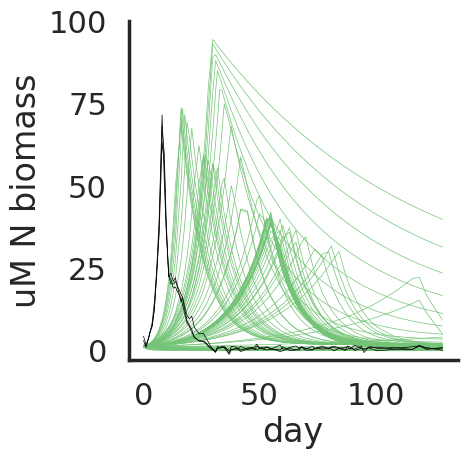

In [83]:

import matplotlib.colors as colors

curdf = sdf.loc[sdf.model.isin(['MIN']) & sdf.media.isin(['lowN']) & sdf['mode'].isin(['ponly'])]


g = sns.relplot(
    data=curdf, x='day', y='Bptotal[N]',
    units='run_id', estimator=None,
     kind='line', #hue_norm=colors.LogNorm(),
     lw=0.5, legend=False, palette='Greens',
    hue='run',
    facet_kws=dict(sharey=False),
)
    
datadf = refdf 
sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
units='Sample', estimator=None,  lw=0.5, color='black',

             legend=False
            )
g.set_titles(col_template='{col_name}', row_template='{row_name}')
g.set(ylabel='uM N biomass')
#plt.suptitle(f'doubled VmaxICp', y=1.05)
plt.ylim((-3,100))
plt.show()


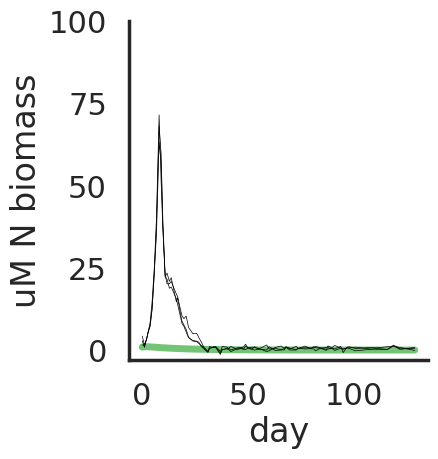

In [85]:

import matplotlib.colors as colors

curdf = init_bdf


g = sns.relplot(
    data=curdf, x='day', y='Bptotal[N]',
    units='run_id', estimator=None,
     kind='line', #hue_norm=colors.LogNorm(),
     lw=5, legend=False, palette='Greens',
    hue='run_id',
    facet_kws=dict(sharey=False),
)
    
datadf = refdf 
sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
units='Sample', estimator=None,  lw=0.5, color='black',

             legend=False
            )
g.set_titles(col_template='{col_name}', row_template='{row_name}')
g.set(ylabel='uM N biomass')
#plt.suptitle(f'doubled VmaxICp', y=1.05)
plt.ylim((-3,100))
plt.show()


In [34]:
sdf.columns

Index(['Bp', 'Np', 'Cp', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC', 'DIC', 'ROS',
       't', 'day', 'gross_uptakeINp', 'gross_uptakeONp', 'gross_uptakeICp',
       'gross_uptakeOCp', 'uptakeNp', 'uptakeCp', 'QCp', 'biosynthesisNp',
       'respirationCp', 'biomass_breakdownCp', 'overflowNp', 'overflowCp',
       'Bp[C]', 'Bptotal[N]', 'Bptotal[C]', 'run_id', 'Bh', 'Nh', 'Ch',
       'gross_uptakeINh', 'gross_uptakeONh', 'gross_uptakeICh',
       'gross_uptakeOCh', 'uptakeNh', 'uptakeCh', 'QCh', 'biosynthesisNh',
       'respirationCh', 'biomass_breakdownCh', 'overflowNh', 'overflowCh',
       'Bh[C]', 'Bhtotal[N]', 'Bhtotal[C]', 'media', 'mode', 'model', 'run',
       'param', 'paramval', 'defaultval', 'paramfc', 'mode/media'],
      dtype='object')

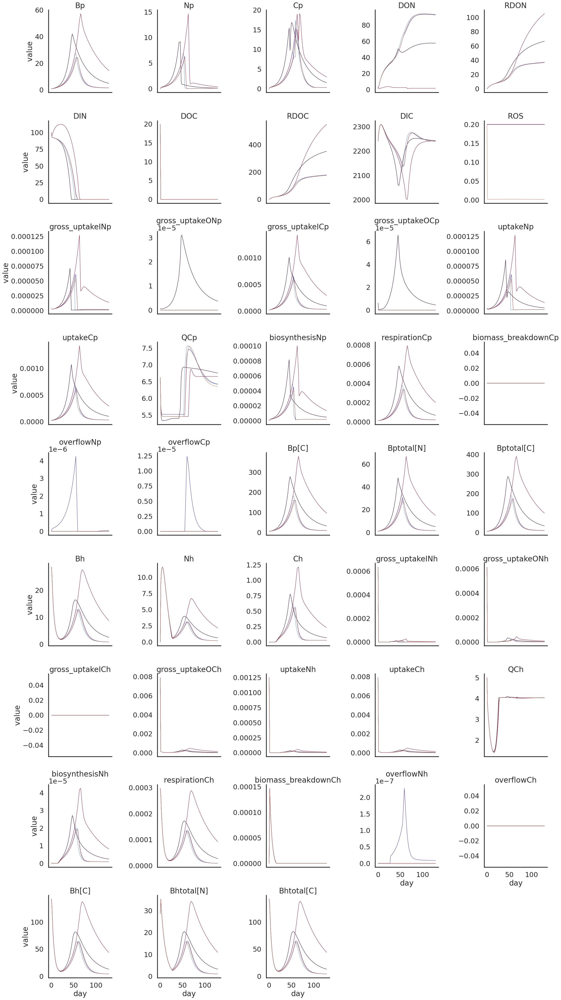

In [35]:
variables_to_track  = [
'Bp', 'Np', 'Cp', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC', 'DIC', 'ROS',
       'gross_uptakeINp', 'gross_uptakeONp', 'gross_uptakeICp',
       'gross_uptakeOCp', 'uptakeNp', 'uptakeCp', 'QCp', 'biosynthesisNp',
       'respirationCp', 'biomass_breakdownCp', 'overflowNp', 'overflowCp',
       'Bp[C]', 'Bptotal[N]', 'Bptotal[C]',  'Bh', 'Nh', 'Ch',
       'gross_uptakeINh', 'gross_uptakeONh', 'gross_uptakeICh',
       'gross_uptakeOCh', 'uptakeNh', 'uptakeCh', 'QCh', 'biosynthesisNh',
       'respirationCh', 'biomass_breakdownCh', 'overflowNh', 'overflowCh',
       'Bh[C]', 'Bhtotal[N]', 'Bhtotal[C]'
]    

import matplotlib.colors as colors
# organism_to_tune = 'PRO'
# pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

# for model in ['OVERFLOW', 'EXOENZYME']: 
#     pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
# curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
#                 ~sdf.param.isin(pro_min_params_to_update) &
#                 sdf['mode'].isin(['all'])
#                ]
mcurdf = bdf.melt(
    id_vars=['run_id', 'day', #'param', 'paramval', 'paramfc', 
             'model', 'mode', 'media', 'mode/media'],
    value_vars=variables_to_track,

).reset_index()

#for p in curdf.param.unique():

g = sns.relplot(
    data=mcurdf.loc[mcurdf['mode/media'].isin(['all'])], 
    x='day', y='value',
    units='run_id', estimator=None,
     kind='line', #hue_norm=colors.LogNorm(),
    col='variable', lw=1, legend=False, palette=mpalette, hue_order=morder,
    col_wrap=5,
    hue='model', 
    facet_kws=dict(sharey=False),
).set_titles(col_template='{col_name}')
#plt.suptitle(f'{p} ({model})', y=1.05)
plt.show()


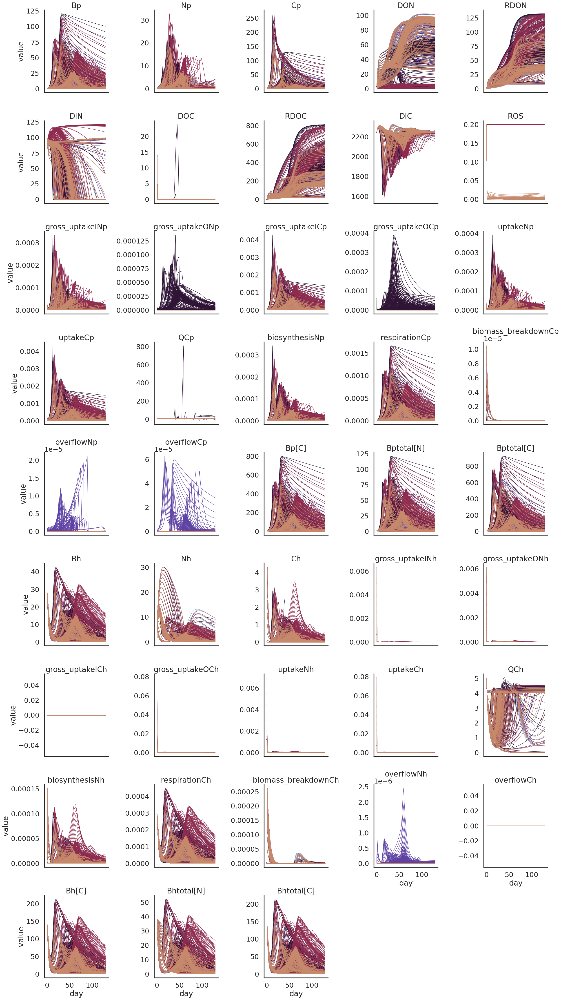

In [36]:
variables_to_track  = [
'Bp', 'Np', 'Cp', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC', 'DIC', 'ROS',
       'gross_uptakeINp', 'gross_uptakeONp', 'gross_uptakeICp',
       'gross_uptakeOCp', 'uptakeNp', 'uptakeCp', 'QCp', 'biosynthesisNp',
       'respirationCp', 'biomass_breakdownCp', 'overflowNp', 'overflowCp',
       'Bp[C]', 'Bptotal[N]', 'Bptotal[C]',  'Bh', 'Nh', 'Ch',
       'gross_uptakeINh', 'gross_uptakeONh', 'gross_uptakeICh',
       'gross_uptakeOCh', 'uptakeNh', 'uptakeCh', 'QCh', 'biosynthesisNh',
       'respirationCh', 'biomass_breakdownCh', 'overflowNh', 'overflowCh',
       'Bh[C]', 'Bhtotal[N]', 'Bhtotal[C]'
]    

import matplotlib.colors as colors
# organism_to_tune = 'PRO'
# pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

# for model in ['OVERFLOW', 'EXOENZYME']: 
#     pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
# curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
#                 ~sdf.param.isin(pro_min_params_to_update) &
#                 sdf['mode'].isin(['all'])
#                ]
mcurdf = sdf.melt(
    id_vars=['run_id', 'day', #'param', 'paramval', 'paramfc', 
             'model', 'mode', 'media', 'mode/media'],
    value_vars=variables_to_track,

).reset_index()

#for p in curdf.param.unique():

g = sns.relplot(
    data=mcurdf.loc[mcurdf['mode/media'].isin(['all'])], 
    x='day', y='value',
    units='run_id', estimator=None,
     kind='line', #hue_norm=colors.LogNorm(),
    col='variable', lw=1, legend=False, palette=mpalette, hue_order=morder,
    col_wrap=5,
    hue='model', 
    facet_kws=dict(sharey=False),
).set_titles(col_template='{col_name}')
plt.show()


In [37]:
sdf.paramfc.describe()

count    235320.000000
mean         -0.177992
std           1.972517
min          -3.321928
25%          -1.923222
50%          -0.330589
75%           1.573545
max           3.321928
Name: paramfc, dtype: float64

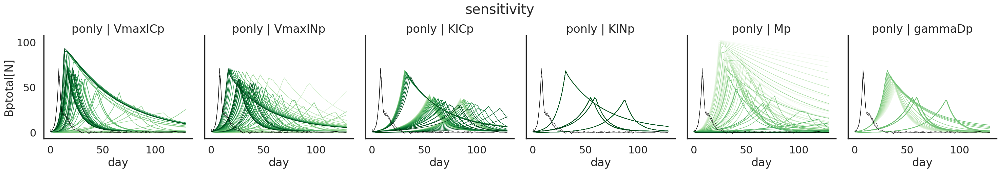

In [38]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
for model in ['MIN']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) 
                    
                   ]
        
    g = sns.relplot(
        data=curdf, x='day', y='Bptotal[N]',
        units='run_id', estimator=None,
         kind='line', #hue_norm=colors.LogNorm(),
     row='mode/media', lw=1, legend=False, palette='Greens',
    row_order=['ponly', #'ponly/pro99', 
               ],
        col='param', col_order=pro_params_to_update,
        #col='model', col_order=morder,
        hue='paramfc', 
    )
    for (row_val, col_val), ax in g.axes_dict.items():
        if row_val == 'all':
            sns.lineplot(
                data=curdf.loc[curdf.param.isin([col_val]) & curdf['mode'].isin(['all']) 
                               
                              ], 
                x='day', y='Bhtotal[N]',
                units='run_id', estimator=None,
                 #hue_norm=colors.LogNorm(),
                 lw=1, legend=False, palette='Oranges',
                hue='paramfc', ax=ax,
            )
        datadf = refdf 
        if row_val == 'ponly/pro99':
            datadf = refp99df
        sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
        units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                     legend=False
                    )
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'sensitivity', y=1.05)
    plt.show()


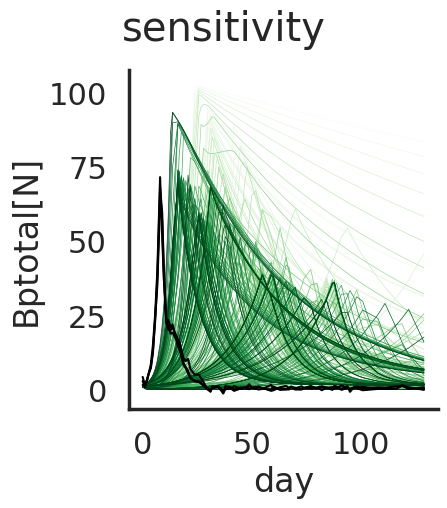

In [68]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
for model in ['MIN']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) &
        sdf['mode/media'].isin(['ponly'])
                    
                   ]
        
    g = sns.relplot(
        data=curdf, x='day', y='Bptotal[N]',
        units='run_id', estimator=None,
         kind='line', #hue_norm=colors.LogNorm(),
     #row='mode/media', 
        lw=0.5, legend=False, palette='Greens',
    row_order=['ponly', #'ponly/pro99', 
               ],
        #col='param', col_order=pro_params_to_update,
        #col='model', col_order=morder,
        hue='paramfc', 
    )
    datadf = refdf 
    #if row_val == 'ponly/pro99':
    #    datadf = refp99df
    sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
    units='Sample', estimator=None,  lw=1.5, color='black',

                 legend=False
                )
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'sensitivity', y=1.05)
    plt.show()


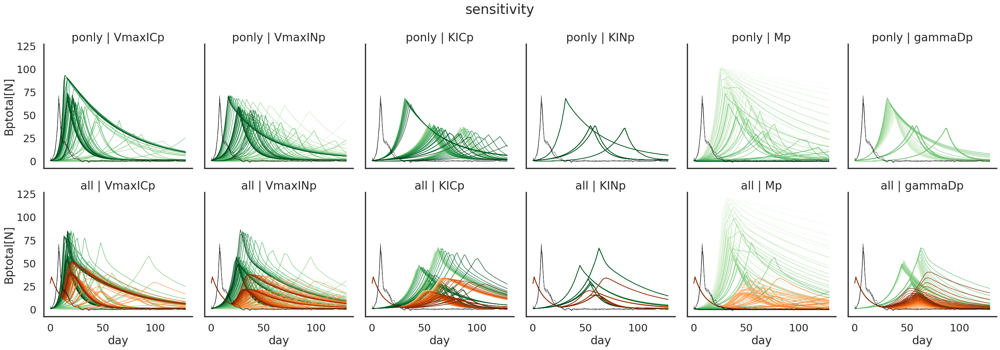

In [39]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
for model in ['MIN']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) 
                    
                   ]
        
    g = sns.relplot(
        data=curdf, x='day', y='Bptotal[N]',
        units='run_id', estimator=None,
         kind='line', #hue_norm=colors.LogNorm(),
     row='mode/media', lw=1, legend=False, palette='Greens',
    row_order=['ponly', #'ponly/pro99', 
               'all'],
        col='param', col_order=pro_params_to_update,
        #col='model', col_order=morder,
        hue='paramfc', 
    )
    for (row_val, col_val), ax in g.axes_dict.items():
        if row_val == 'all':
            sns.lineplot(
                data=curdf.loc[curdf.param.isin([col_val]) & curdf['mode'].isin(['all']) 
                               
                              ], 
                x='day', y='Bhtotal[N]',
                units='run_id', estimator=None,
                 #hue_norm=colors.LogNorm(),
                 lw=1, legend=False, palette='Oranges',
                hue='paramfc', ax=ax,
            )
        datadf = refdf 
        if row_val == 'ponly/pro99':
            datadf = refp99df
        sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
        units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                     legend=False
                    )
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'sensitivity', y=1.05)
    plt.show()


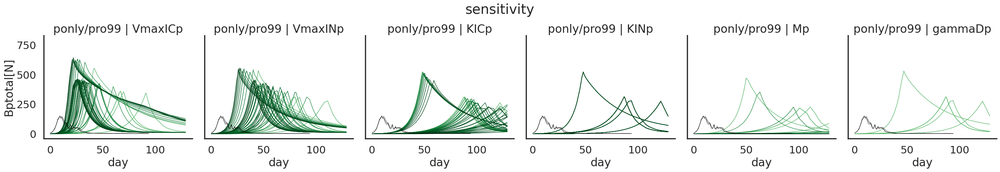

In [40]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
for model in ['MIN']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) 
                    
                   ]
        
    g = sns.relplot(
        data=curdf, x='day', y='Bptotal[N]',
        units='run_id', estimator=None,
         kind='line', hue_norm=colors.LogNorm(),
     row='mode/media', lw=1, legend=False, palette='Greens',
    row_order=['ponly/pro99', 
               ],
        col='param', col_order=pro_params_to_update,
        #col='model', col_order=morder,
        hue='paramfc', 
    )
    for (row_val, col_val), ax in g.axes_dict.items():
        if row_val == 'all':
            sns.lineplot(
                data=curdf.loc[curdf.param.isin([col_val]) & curdf['mode'].isin(['all']) 
                               
                              ], 
                x='day', y='Bhtotal[N]',
                units='run_id', estimator=None,
                 hue_norm=colors.LogNorm(),
                 lw=1, legend=False, palette='Oranges',
                hue='paramfc', ax=ax,
            )
        datadf = refdf 
        if row_val == 'ponly/pro99':
            datadf = refp99df
        sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
        units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                     legend=False
                    )
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'sensitivity', y=1.05)
    plt.show()


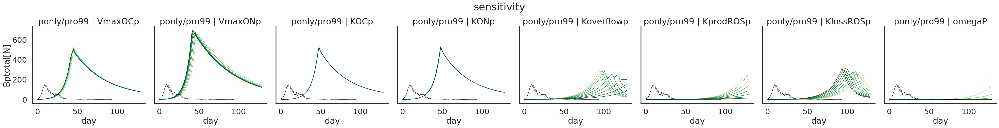

In [41]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
min_pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)
final_params_to_update = set()
porder = list()
for model in ['MIXOTROPH', 'OVERFLOW', 'EXOENZYME', 'ROS']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)
    final_params_to_update = (final_params_to_update | set(pro_params_to_update)) - set(min_pro_params_to_update)
    porder += [p for p in pro_params_to_update if p in final_params_to_update]

curdf = sdf.loc[
                sdf.param.isin(final_params_to_update) 

               ]

g = sns.relplot(
    data=curdf, x='day', y='Bptotal[N]',
    units='run_id', estimator=None,
     kind='line', hue_norm=colors.LogNorm(),
 row='mode/media', lw=1, legend=False, palette='Greens',
row_order=['ponly/pro99', 
           ],
    col='param', col_order=porder,
    #col='model', col_order=morder,
    hue='paramfc', 
)
for (row_val, col_val), ax in g.axes_dict.items():
    if row_val == 'all':
        sns.lineplot(
            data=curdf.loc[curdf.param.isin([col_val]) & curdf['mode'].isin(['all']) 

                          ], 
            x='day', y='Bhtotal[N]',
            units='run_id', estimator=None,
             hue_norm=colors.LogNorm(),
             lw=1, legend=False, palette='Oranges',
            hue='paramfc', ax=ax,
        )
    datadf = refdf 
    if row_val == 'ponly/pro99':
        datadf = refp99df
    sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
    units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                 legend=False
                )
g.set_titles(col_template='{col_name}', row_template='{row_name}')
plt.suptitle(f'sensitivity', y=1.05)
plt.show()


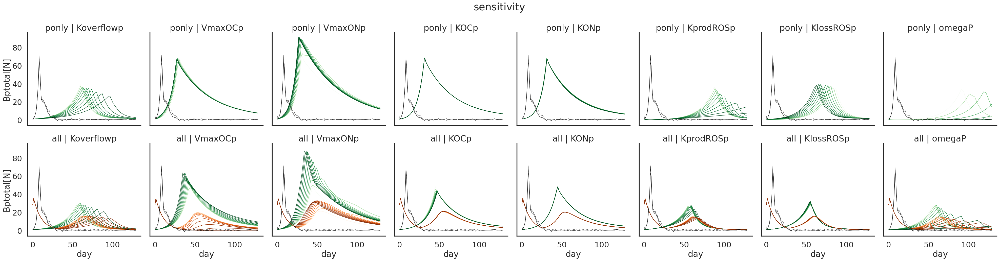

In [42]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
min_pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)
final_params_to_update = set()
porder = list()
for model in ['OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)
    final_params_to_update = (final_params_to_update | set(pro_params_to_update)) - set(min_pro_params_to_update)
    porder += [p for p in pro_params_to_update if p in final_params_to_update]

curdf = sdf.loc[
                sdf.param.isin(final_params_to_update) 

               ]

g = sns.relplot(
    data=curdf, x='day', y='Bptotal[N]',
    units='run_id', estimator=None,
     kind='line', hue_norm=colors.LogNorm(),
 row='mode/media', lw=1, legend=False, palette='Greens',
row_order=['ponly', 'all'
           ],
    col='param', col_order=porder,
    #col='model', col_order=morder,
    hue='paramfc', 
)
for (row_val, col_val), ax in g.axes_dict.items():
    if row_val == 'all':
        sns.lineplot(
            data=curdf.loc[curdf.param.isin([col_val]) & curdf['mode'].isin(['all']) 

                          ], 
            x='day', y='Bhtotal[N]',
            units='run_id', estimator=None,
             hue_norm=colors.LogNorm(),
             lw=1, legend=False, palette='Oranges',
            hue='paramfc', ax=ax,
        )
    datadf = refdf 
    if row_val == 'ponly/pro99':
        datadf = refp99df
    sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
    units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                 legend=False
                )
g.set_titles(col_template='{col_name}', row_template='{row_name}')
plt.suptitle(f'sensitivity', y=1.05)
plt.show()


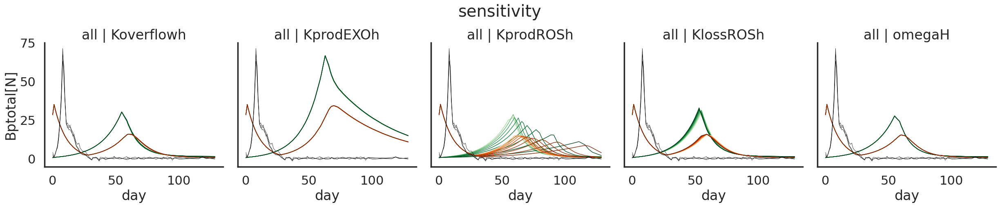

In [43]:

import matplotlib.colors as colors
organism_to_tune = 'HET'
min_pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)
final_params_to_update = set()
porder = list()
for model in ['OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)
    final_params_to_update = (final_params_to_update | set(pro_params_to_update)) - set(min_pro_params_to_update)
    porder += [p for p in pro_params_to_update if p in final_params_to_update]

curdf = sdf.loc[
                sdf.param.isin(final_params_to_update) 

               ]

g = sns.relplot(
    data=curdf, x='day', y='Bptotal[N]',
    units='run_id', estimator=None,
     kind='line', hue_norm=colors.LogNorm(),
 row='mode/media', lw=1, legend=False, palette='Greens',
row_order=['all'
           ],
    col='param', col_order=porder,
    #col='model', col_order=morder,
    hue='paramfc', 
)
for (row_val, col_val), ax in g.axes_dict.items():
    if row_val == 'all':
        sns.lineplot(
            data=curdf.loc[curdf.param.isin([col_val]) & curdf['mode'].isin(['all']) 

                          ], 
            x='day', y='Bhtotal[N]',
            units='run_id', estimator=None,
             hue_norm=colors.LogNorm(),
             lw=1, legend=False, palette='Oranges',
            hue='paramfc', ax=ax,
        )
    datadf = refdf 
    if row_val == 'ponly/pro99':
        datadf = refp99df
    sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
    units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                 legend=False
                )
g.set_titles(col_template='{col_name}', row_template='{row_name}')
plt.suptitle(f'sensitivity', y=1.05)
plt.show()


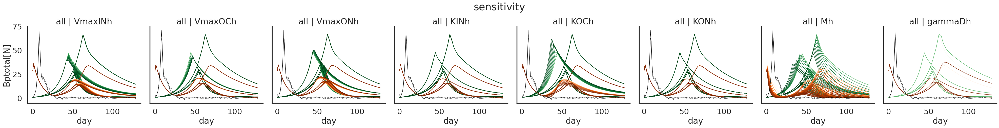

In [44]:

import matplotlib.colors as colors
organism_to_tune = 'HET'
for model in ['MIN']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) 
                    
                   ]
        
    g = sns.relplot(
        data=curdf, x='day', y='Bptotal[N]',
        units='run_id', estimator=None,
         kind='line', hue_norm=colors.LogNorm(),
     row='mode/media', lw=1, legend=False, palette='Greens',
    row_order=[# 'ponly', #'ponly/pro99', 
               'all'],
        col='param', col_order=pro_params_to_update,
        #col='model', col_order=morder,
        hue='paramfc', 
    )
    for (row_val, col_val), ax in g.axes_dict.items():
        if row_val == 'all':
            sns.lineplot(
                data=curdf.loc[curdf.param.isin([col_val]) & curdf['mode'].isin(['all']) 
                               
                              ], 
                x='day', y='Bhtotal[N]',
                units='run_id', estimator=None,
                 hue_norm=colors.LogNorm(),
                 lw=1, legend=False, palette='Oranges',
                hue='paramfc', ax=ax,
            )
        datadf = refdf 
        if row_val == 'ponly/pro99':
            datadf = refp99df
        sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
        units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                     legend=False
                    )
    g.set_titles(col_template='{col_name}', row_template='{row_name}')
    plt.suptitle(f'sensitivity', y=1.05)
    plt.show()


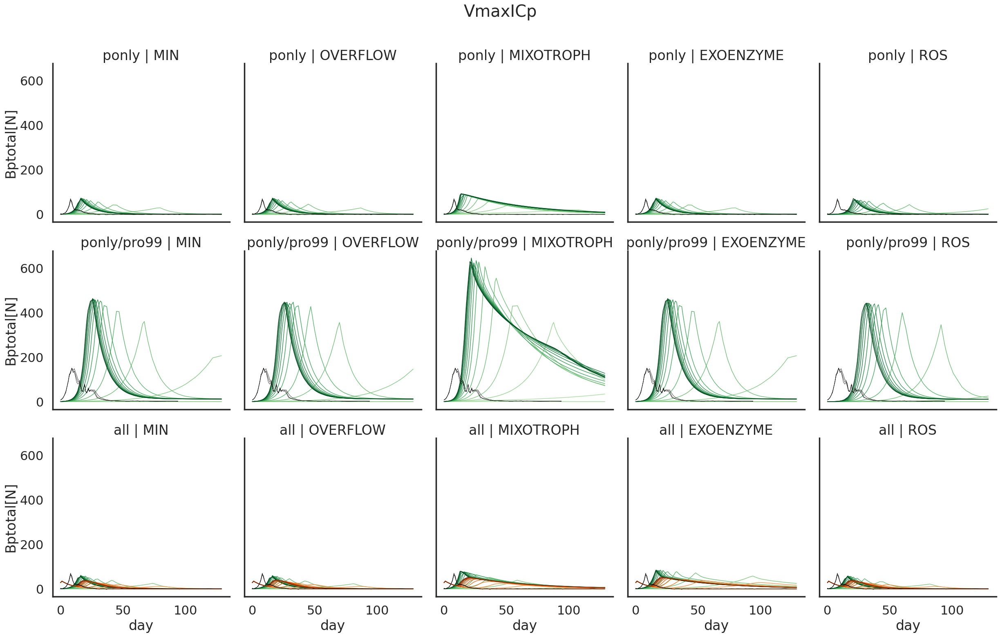

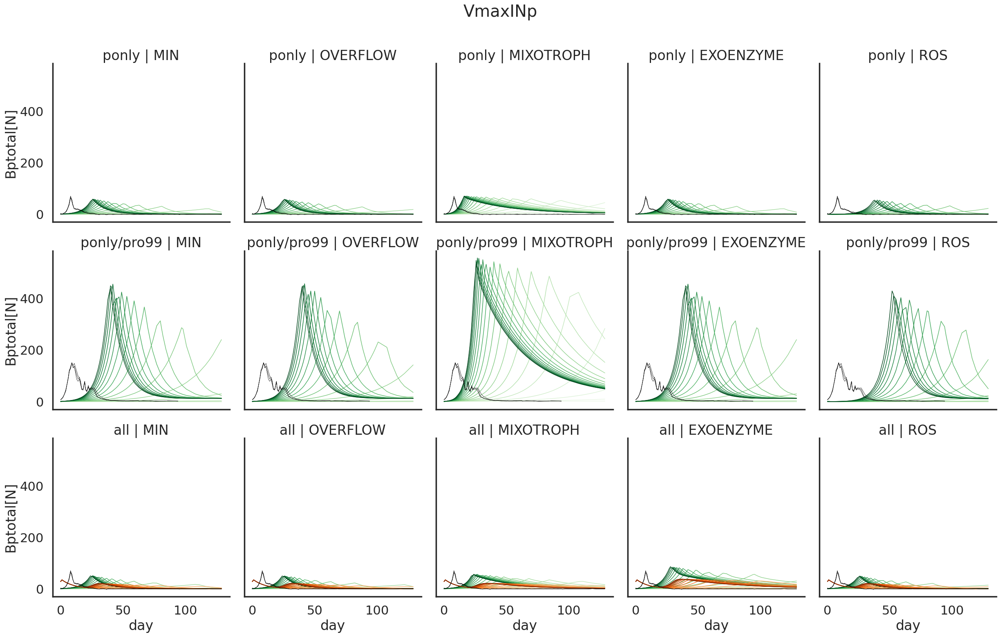

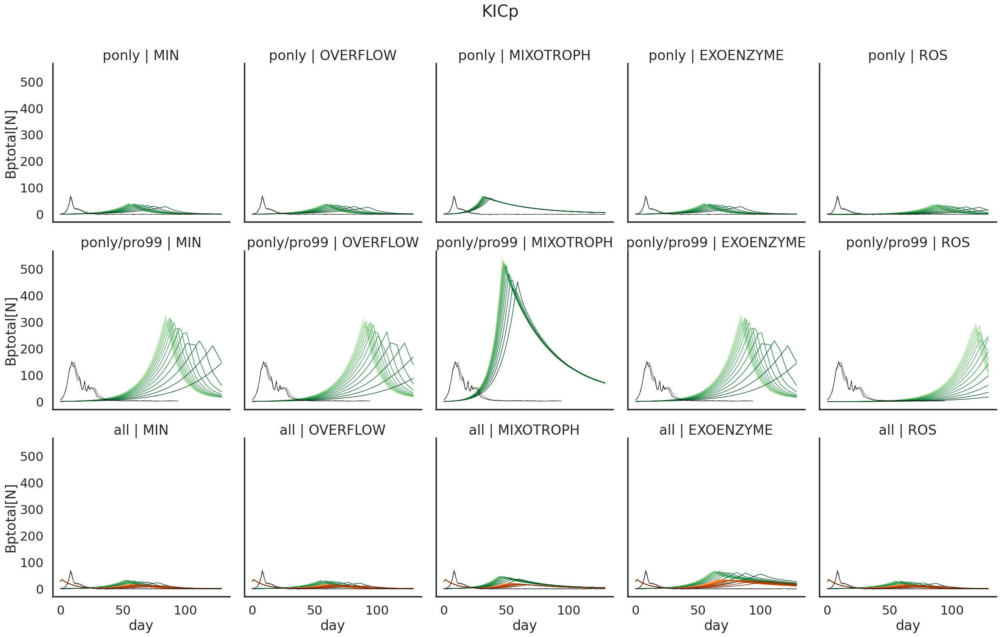

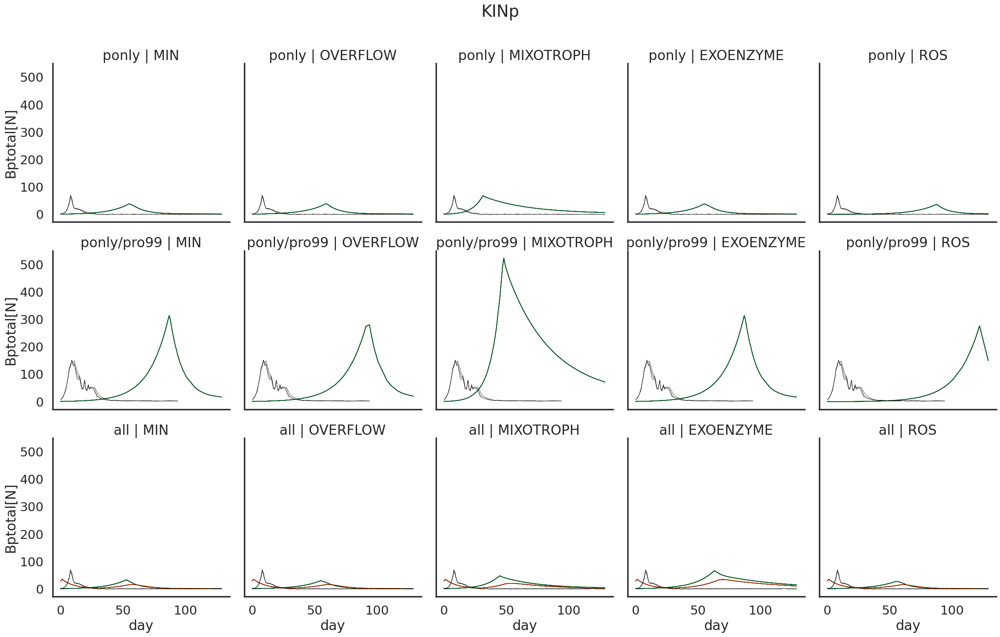

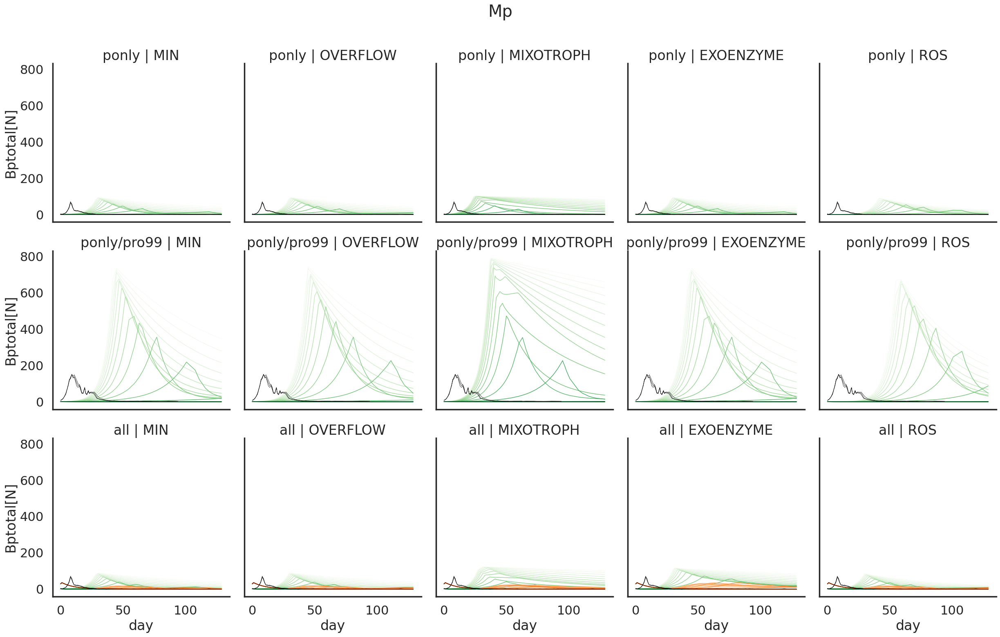

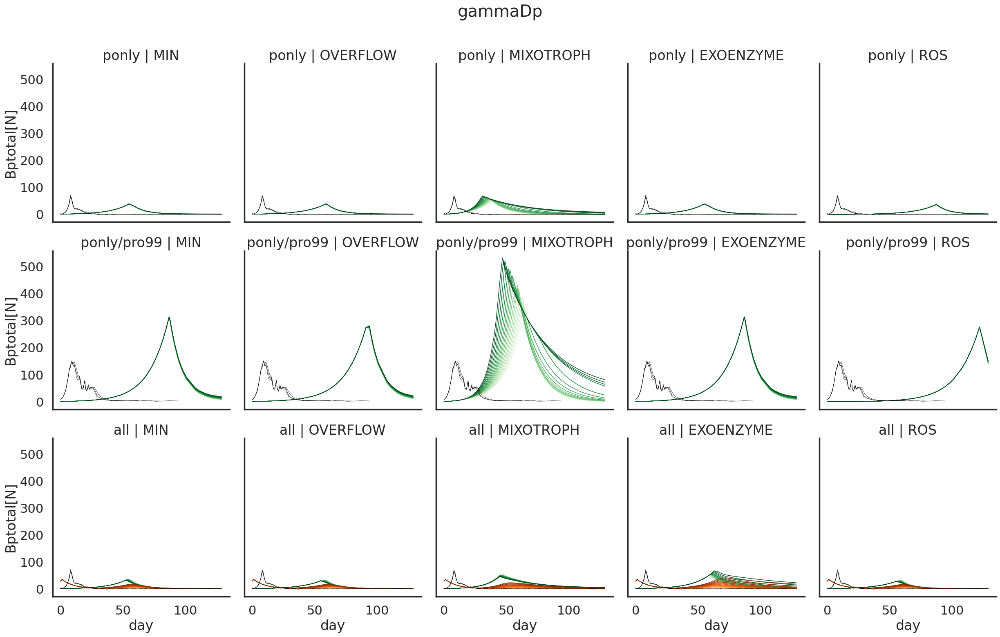

In [45]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
for model in ['MIN']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) 
                    
                   ]
    for p in pro_params_to_update:
        
        g = sns.relplot(
            data=curdf.loc[curdf.param.isin([p])], x='day', y='Bptotal[N]',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
         row='mode/media', lw=1, legend=False, palette='Greens',
        row_order=['ponly', 'ponly/pro99', 'all'],
            col='model', col_order=morder,
            hue='paramval', 
        )
        for (row_val, col_val), ax in g.axes_dict.items():
            if row_val == 'all':
                sns.lineplot(
                    data=curdf.loc[curdf.param.isin([p]) & curdf['mode'].isin(['all']) &
                                   curdf.model.isin([col_val])
                                  ], 
                    x='day', y='Bhtotal[N]',
                    units='run_id', estimator=None,
                     hue_norm=colors.LogNorm(),
                     lw=1, legend=False, palette='Oranges',
                    hue='paramval', ax=ax,
                )
            datadf = refdf 
            if row_val == 'ponly/pro99':
                datadf = refp99df
            sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
            units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                         legend=False
                        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        plt.suptitle(f'{p}', y=1.05)
        plt.show()


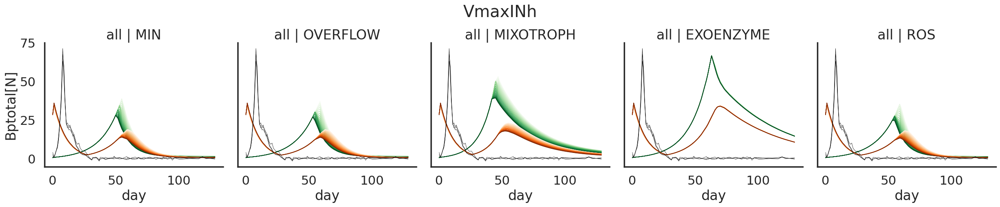

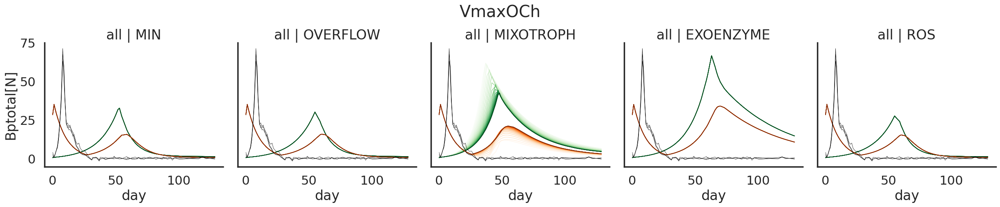

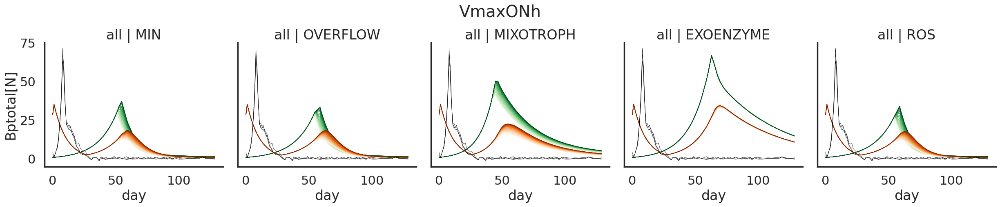

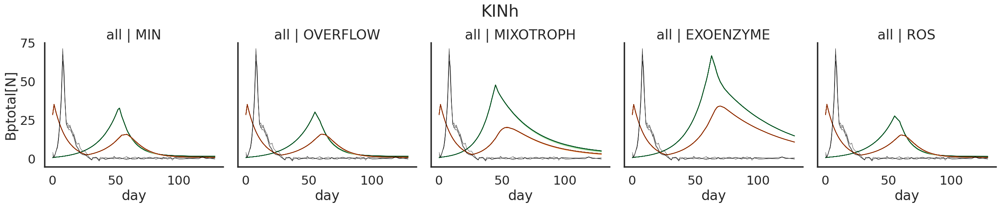

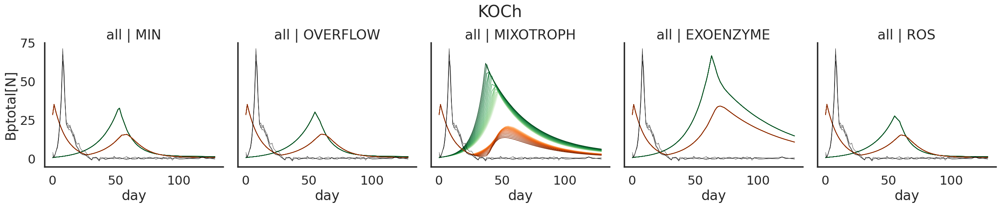

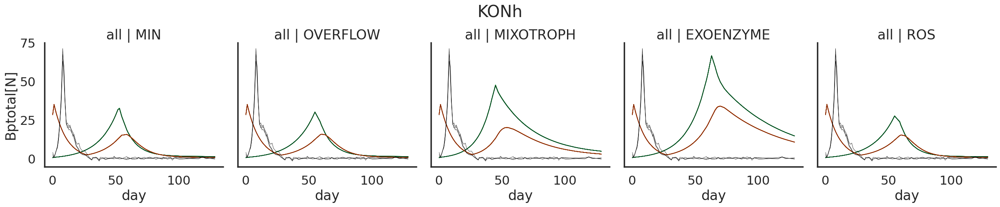

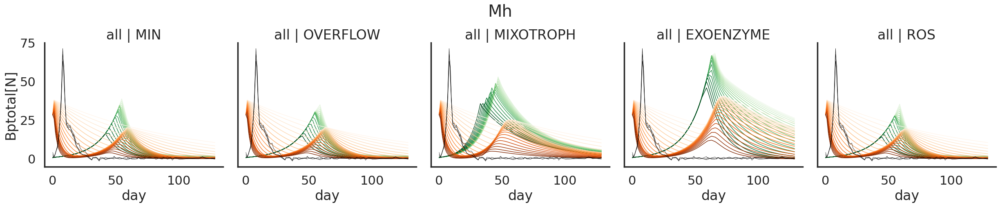

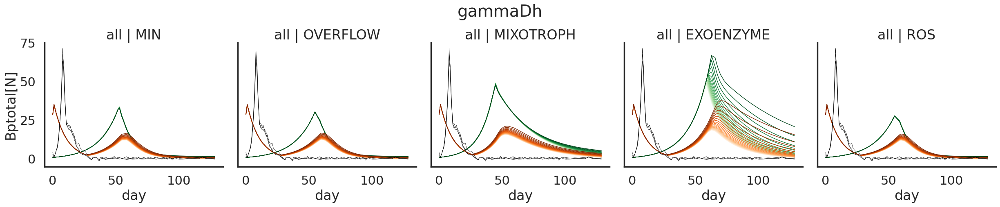

In [46]:

import matplotlib.colors as colors
organism_to_tune = 'HET'
for model in ['MIN']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) & sdf['mode'].isin(['all'])
                    
                   ]
    for p in pro_params_to_update:
        
        g = sns.relplot(
            data=curdf.loc[curdf.param.isin([p])], x='day', y='Bptotal[N]',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
         row='mode/media', lw=1, legend=False, palette='Greens',
        #row_order=['ponly', 'ponly/pro99', 'all'],
            col='model', col_order=morder,
            hue='paramval', 
        )
        for (row_val, col_val), ax in g.axes_dict.items():
            if row_val == 'all':
                sns.lineplot(
                    data=curdf.loc[curdf.param.isin([p]) & curdf['mode'].isin(['all']) &
                                   curdf.model.isin([col_val])
                                  ], 
                    x='day', y='Bhtotal[N]',
                    units='run_id', estimator=None,
                     hue_norm=colors.LogNorm(),
                     lw=1, legend=False, palette='Oranges',
                    hue='paramval', ax=ax,
                )
            datadf = refdf 
            if row_val == 'ponly/pro99':
                datadf = refp99df
            sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
            units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                         legend=False
                        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        plt.suptitle(f'{p}', y=1.05)
        plt.show()


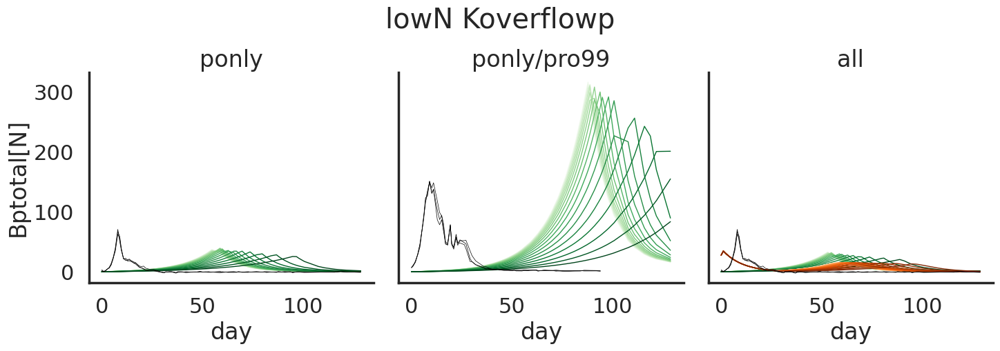

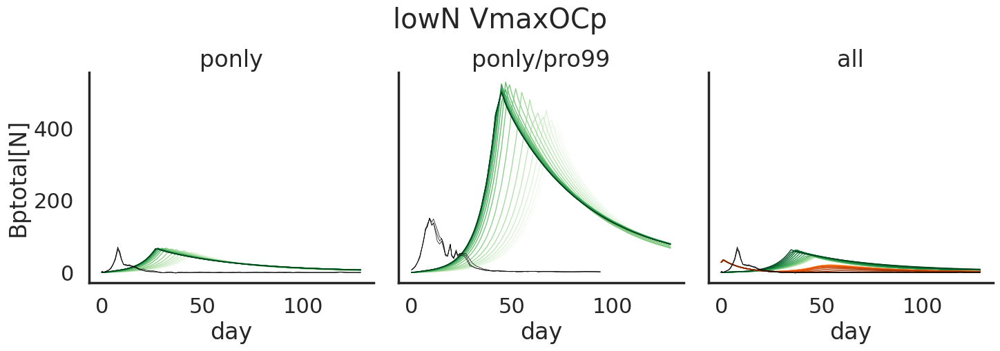

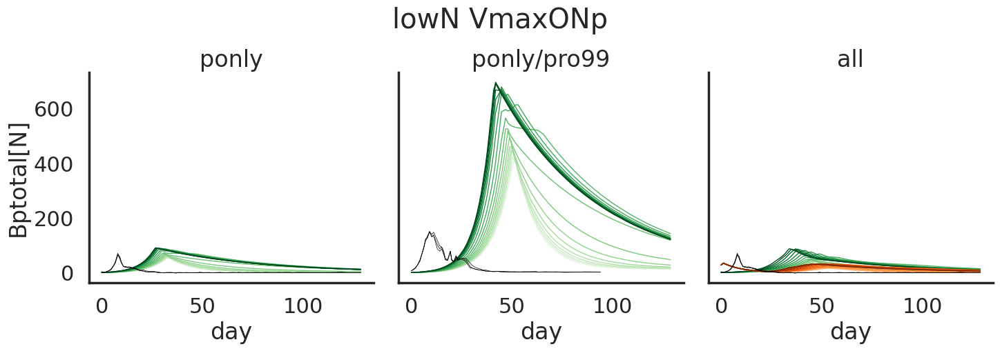

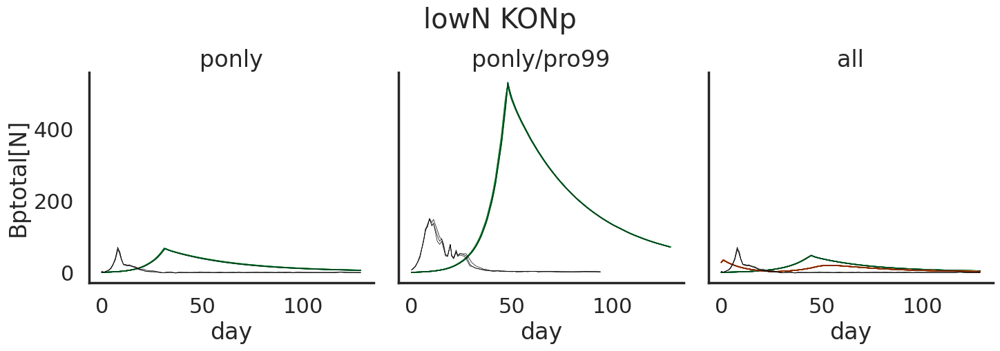

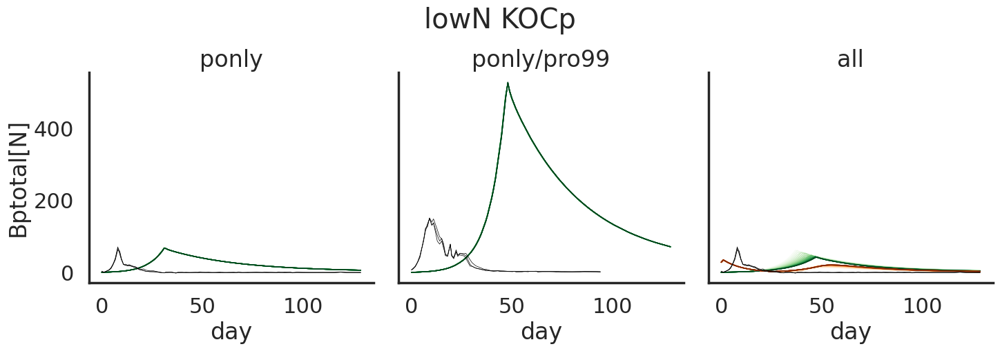

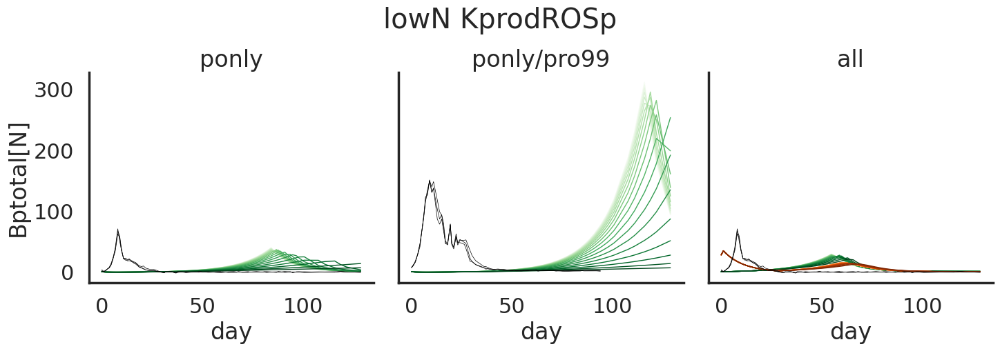

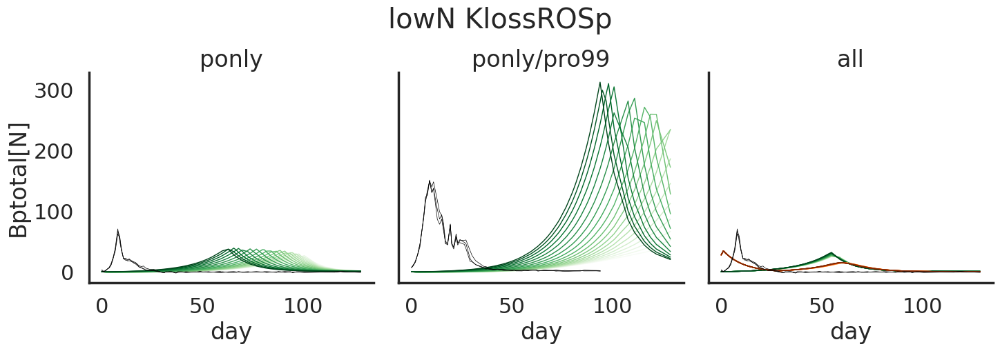

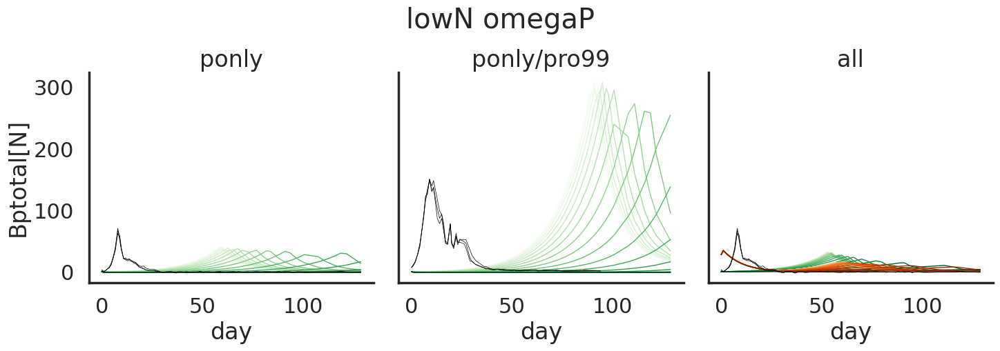

In [47]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
min_pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)
for model in ['OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)
    pro_params_to_update = set(pro_params_to_update) - set(min_pro_params_to_update)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) 
                    
                   ]
    for p in pro_params_to_update:
        
        g = sns.relplot(
            data=curdf.loc[curdf.param.isin([p])], x='day', y='Bptotal[N]',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
         col='mode/media', lw=1, legend=False, palette='Greens',
        col_order=['ponly', 'ponly/pro99', 'all'],
            #col='model', col_order=morder,
            hue='paramval', 
        )
        for row_val, ax in g.axes_dict.items():
            if row_val == 'all':
                sns.lineplot(
                    data=curdf.loc[curdf.param.isin([p]) & curdf['mode'].isin(['all']) #&
                                   #curdf.model.isin([col_val])
                                  ], 
                    x='day', y='Bhtotal[N]',
                    units='run_id', estimator=None,
                     hue_norm=colors.LogNorm(),
                     lw=1, legend=False, palette='Oranges',
                    hue='paramval', ax=ax,
                )
            datadf = refdf 
            if row_val == 'ponly/pro99':
                datadf = refp99df
            sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
            units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                         legend=False
                        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        plt.suptitle(f'lowN {p}', y=1.05)
        plt.show()


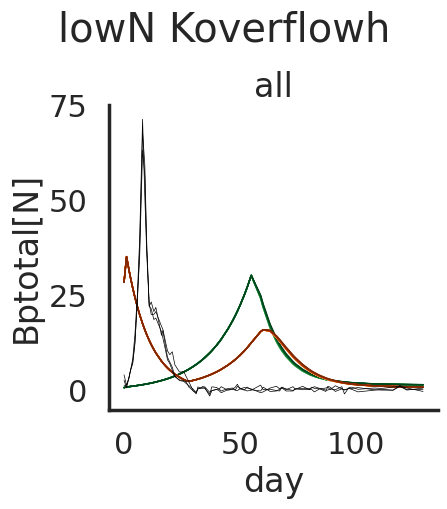

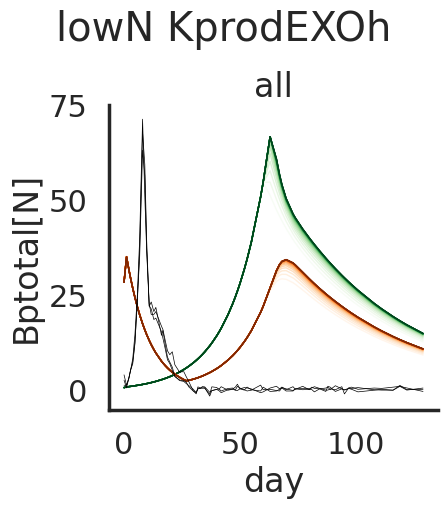

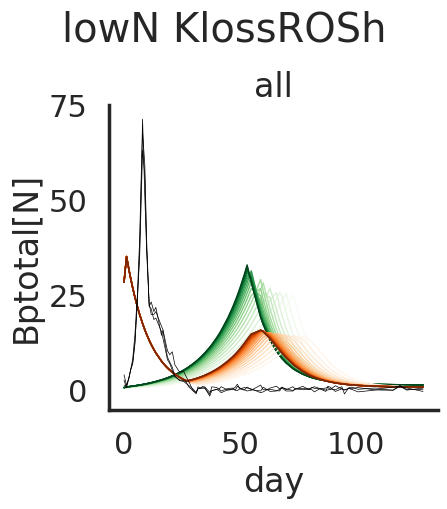

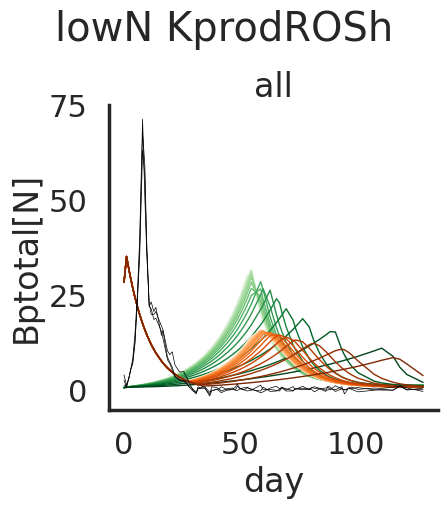

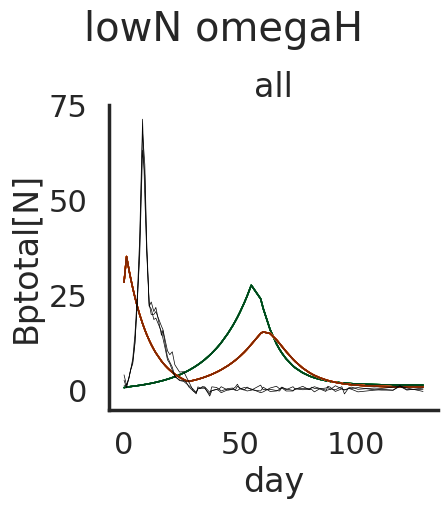

In [48]:

import matplotlib.colors as colors
organism_to_tune = 'HET'
min_pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)
for model in ['OVERFLOW', 'MIXOTROPH', 'EXOENZYME', 'ROS']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)
    pro_params_to_update = set(pro_params_to_update) - set(min_pro_params_to_update)

    curdf = sdf.loc[
                    sdf.param.isin(pro_params_to_update) &
                    sdf['mode'].isin(['all']) 
                    
                   ]
    for p in pro_params_to_update:
        
        g = sns.relplot(
            data=curdf.loc[curdf.param.isin([p])], x='day', y='Bptotal[N]',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
         col='mode/media', lw=1, legend=False, palette='Greens',
        #col_order=['ponly', 'ponly/pro99', 'all'],
            #col='model', col_order=morder,
            hue='paramval', 
        )
        for row_val, ax in g.axes_dict.items():
            if row_val == 'all':
                sns.lineplot(
                    data=curdf.loc[curdf.param.isin([p]) & curdf['mode'].isin(['all']) #&
                                   #curdf.model.isin([col_val])
                                  ], 
                    x='day', y='Bhtotal[N]',
                    units='run_id', estimator=None,
                     hue_norm=colors.LogNorm(),
                     lw=1, legend=False, palette='Oranges',
                    hue='paramval', ax=ax,
                )
            datadf = refdf 
            if row_val == 'ponly/pro99':
                datadf = refp99df
            sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
            units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                         legend=False
                        )
        g.set_titles(col_template='{col_name}', row_template='{row_name}')
        plt.suptitle(f'lowN {p}', y=1.05)
        plt.show()


In [49]:
param_vals['VmaxICp']

5.555555555555556e-06

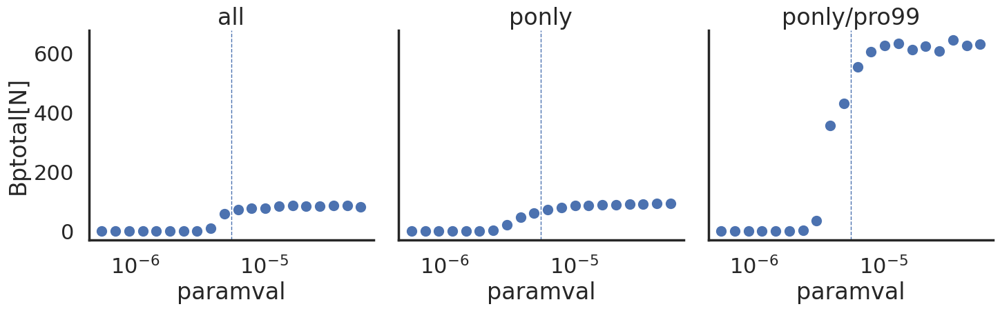

In [50]:
g = sns.relplot(
    data=sdf.loc[sdf.param.isin(['VmaxICp'])].groupby(['mode/media', 'paramval'])['Bptotal[N]'].max().reset_index(),
    x='paramval', y='Bptotal[N]',
    col='mode/media'
).set(xscale='log')
for col_val, ax in g.axes_dict.items():
    ax.axvline(x=param_vals['VmaxICp'], ls='--', lw=1)
g.set_titles(col_template='{col_name}', row_template='{row_name}')
g.set(xscale='log')
    
plt.show()

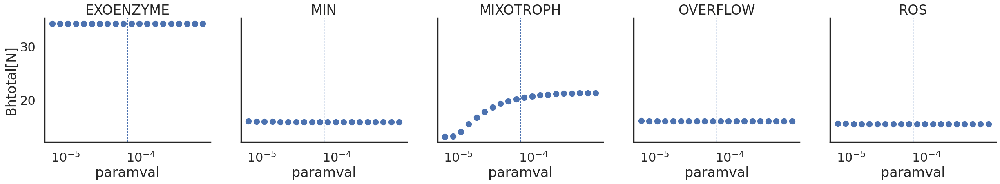

In [51]:
g = sns.relplot(
    data=sdf.loc[sdf.param.isin(['VmaxOCh']) & sdf.day.ge(10)].groupby(['model', 'paramval'])['Bhtotal[N]'].max().reset_index(),
    x='paramval', y='Bhtotal[N]',
    col='model'
).set(xscale='log')
for col_val, ax in g.axes_dict.items():
    ax.axvline(x=param_vals['VmaxOCh'], ls='--', lw=1)
g.set_titles(col_template='{col_name}', row_template='{row_name}')
g.set(xscale='log')
    
plt.show()

In [52]:
sdf.loc[sdf.param.isin(['VmaxICp'])].groupby(['mode/media', 'paramval'])['Bptotal[N]'].max(
).reset_index().pivot(index='paramval', columns='mode/media')

Bptotal[N]                       
mode/media          all      ponly ponly/pro99
paramval                                      
5.555556e-07   0.991992   1.032051    1.032077
7.079305e-07   0.994988   1.041617    1.041644
9.020982e-07   0.998779   1.053668    1.053697
1.149521e-06   1.003610   1.068831    1.068862
1.464806e-06   1.009764   1.089226    1.089261
1.866566e-06   1.017603   1.135378    1.135423
2.378518e-06   1.032099   2.935037    2.935381
3.030886e-06   1.072023  21.941556   34.696569
3.862182e-06   8.740341  47.577705  356.189464
4.921482e-06  58.179411  60.624265  431.206302
6.271322e-06  72.501957  72.174423  555.063437
7.991388e-06  77.764862  78.052633  606.517638
1.018323e-05  77.528262  85.881968  627.460888
1.297623e-05  83.378327  86.631925  634.086262
1.653529e-05  85.241500  89.391719  612.791588
2.107050e-05  83.360732  89.282332  624.278214
2.684961e-05  83.344889  89.670367  607.293368
3.421379e-05  85.039376  90.054513  645.767652
4.359778e-05  85.156126  93.201925  626.394768
5.555556e-05  82.065312  93.306912  629.949330

In [53]:
sdf.columns

Index(['Bp', 'Np', 'Cp', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC', 'DIC', 'ROS',
       't', 'day', 'gross_uptakeINp', 'gross_uptakeONp', 'gross_uptakeICp',
       'gross_uptakeOCp', 'uptakeNp', 'uptakeCp', 'QCp', 'biosynthesisNp',
       'respirationCp', 'biomass_breakdownCp', 'overflowNp', 'overflowCp',
       'Bp[C]', 'Bptotal[N]', 'Bptotal[C]', 'run_id', 'Bh', 'Nh', 'Ch',
       'gross_uptakeINh', 'gross_uptakeONh', 'gross_uptakeICh',
       'gross_uptakeOCh', 'uptakeNh', 'uptakeCh', 'QCh', 'biosynthesisNh',
       'respirationCh', 'biomass_breakdownCh', 'overflowNh', 'overflowCh',
       'Bh[C]', 'Bhtotal[N]', 'Bhtotal[C]', 'media', 'mode', 'model', 'run',
       'param', 'paramval', 'defaultval', 'paramfc', 'mode/media'],
      dtype='object')

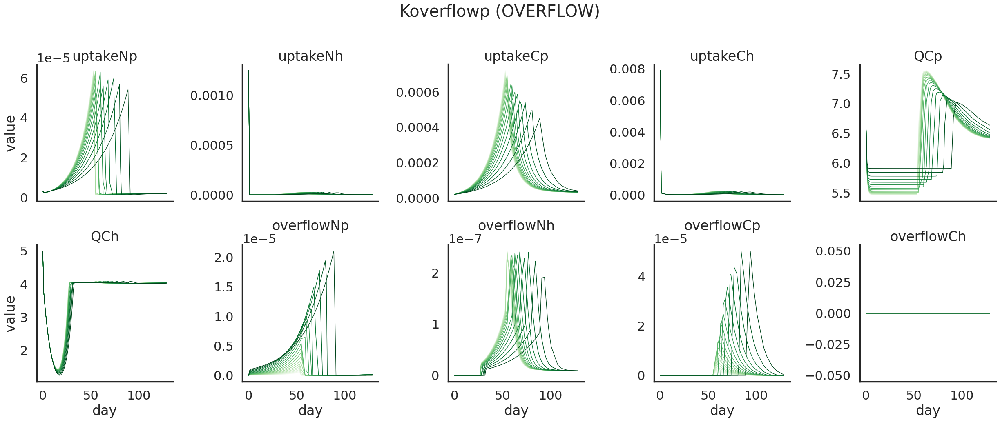

In [54]:
variables_to_track  = [
'uptakeNp','uptakeNh', 'uptakeCp', 'uptakeCh', 'QCp', 'QCh', 
 'overflowNp', 'overflowNh', 'overflowCp', 'overflowCh', 
]

import matplotlib.colors as colors
organism_to_tune = 'PRO'
pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

for model in ['OVERFLOW', 'EXOENZYME']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
    curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
                    ~sdf.param.isin(pro_min_params_to_update) &
                    sdf['mode'].isin(['all'])
                   ]
    mcurdf = curdf.melt(
        id_vars=['run_id', 'day', 'param', 'paramval'],
        value_vars=variables_to_track,
        
    ).reset_index()

    for p in curdf.param.unique():
        
        g = sns.relplot(
            data=mcurdf.loc[mcurdf.param.isin([p])], x='day', y='value',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
            col='variable', lw=1, legend=False, palette='Greens',
            col_wrap=5,
            hue='paramval', 
            facet_kws=dict(sharey=False),
        ).set_titles(col_template='{col_name}')
        plt.suptitle(f'{p} ({model})', y=1.05)
        plt.show()


In [55]:
sdf.columns

Index(['Bp', 'Np', 'Cp', 'DON', 'RDON', 'DIN', 'DOC', 'RDOC', 'DIC', 'ROS',
       't', 'day', 'gross_uptakeINp', 'gross_uptakeONp', 'gross_uptakeICp',
       'gross_uptakeOCp', 'uptakeNp', 'uptakeCp', 'QCp', 'biosynthesisNp',
       'respirationCp', 'biomass_breakdownCp', 'overflowNp', 'overflowCp',
       'Bp[C]', 'Bptotal[N]', 'Bptotal[C]', 'run_id', 'Bh', 'Nh', 'Ch',
       'gross_uptakeINh', 'gross_uptakeONh', 'gross_uptakeICh',
       'gross_uptakeOCh', 'uptakeNh', 'uptakeCh', 'QCh', 'biosynthesisNh',
       'respirationCh', 'biomass_breakdownCh', 'overflowNh', 'overflowCh',
       'Bh[C]', 'Bhtotal[N]', 'Bhtotal[C]', 'media', 'mode', 'model', 'run',
       'param', 'paramval', 'defaultval', 'paramfc', 'mode/media'],
      dtype='object')

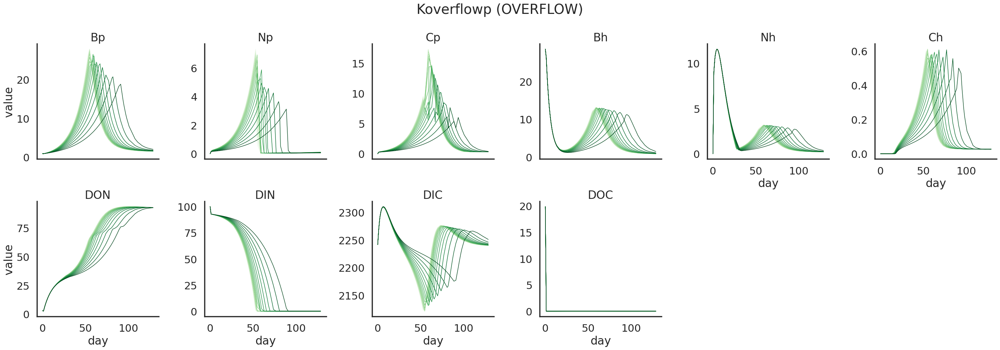

In [56]:
variables_to_track  = [
'Bp', 'Np', 'Cp', 'Bh', 'Nh', 'Ch','DON','DIN', 'DIC', 'DOC' 
]

import matplotlib.colors as colors
organism_to_tune = 'PRO'
pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

for model in ['OVERFLOW', 'EXOENZYME']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
    curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
                    ~sdf.param.isin(pro_min_params_to_update) &
                    sdf['mode'].isin(['all'])
                   ]
    mcurdf = curdf.melt(
        id_vars=['run_id', 'day', 'param', 'paramval'],
        value_vars=variables_to_track,
        
    ).reset_index()

    for p in curdf.param.unique():
        
        g = sns.relplot(
            data=mcurdf.loc[mcurdf.param.isin([p])], x='day', y='value',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
            col='variable', lw=1, legend=False, palette='Greens',
            col_wrap=6,
            hue='paramval', 
            facet_kws=dict(sharey=False),
        ).set_titles(col_template='{col_name}')
        plt.suptitle(f'{p} ({model})', y=1.05)
        plt.show()


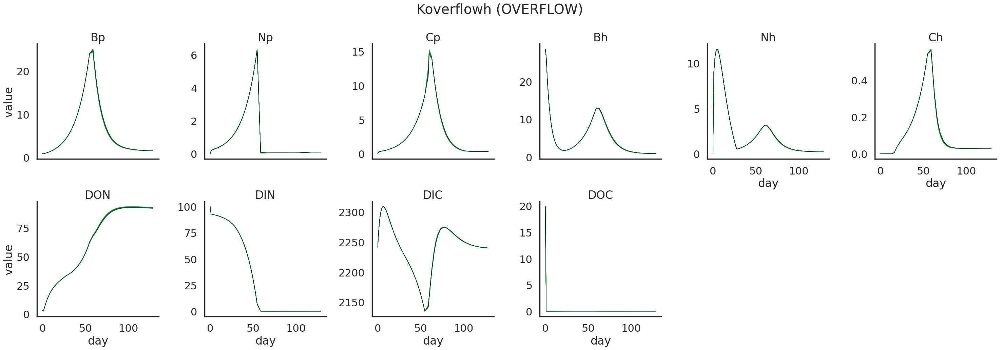

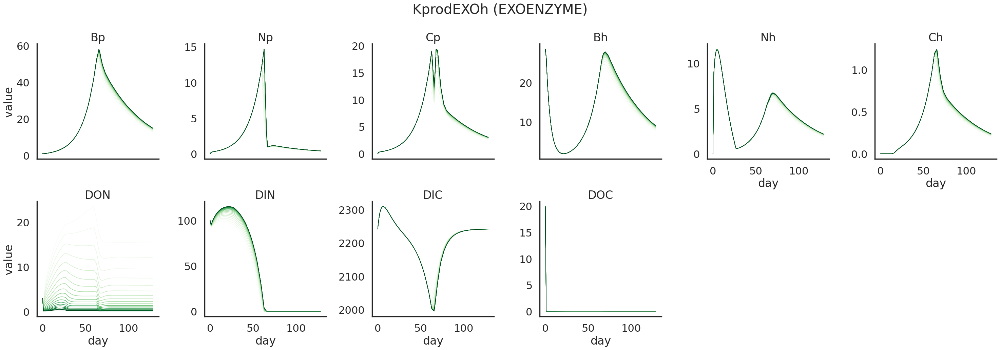

In [57]:
variables_to_track  = [
'Bp', 'Np', 'Cp', 'Bh', 'Nh', 'Ch','DON','DIN', 'DIC', 'DOC' 
]

import matplotlib.colors as colors
organism_to_tune = 'HET'
pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

for model in ['OVERFLOW', 'EXOENZYME']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
    curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
                    ~sdf.param.isin(pro_min_params_to_update) &
                    sdf['mode'].isin(['all'])
                   ]
    mcurdf = curdf.melt(
        id_vars=['run_id', 'day', 'param', 'paramval'],
        value_vars=variables_to_track,
        
    ).reset_index()

    for p in curdf.param.unique():
        
        g = sns.relplot(
            data=mcurdf.loc[mcurdf.param.isin([p])], x='day', y='value',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
            col='variable', lw=1, legend=False, palette='Greens',
            col_wrap=6,
            hue='paramval', 
            facet_kws=dict(sharey=False),
        ).set_titles(col_template='{col_name}')
        plt.suptitle(f'{p} ({model})', y=1.05)
        plt.show()


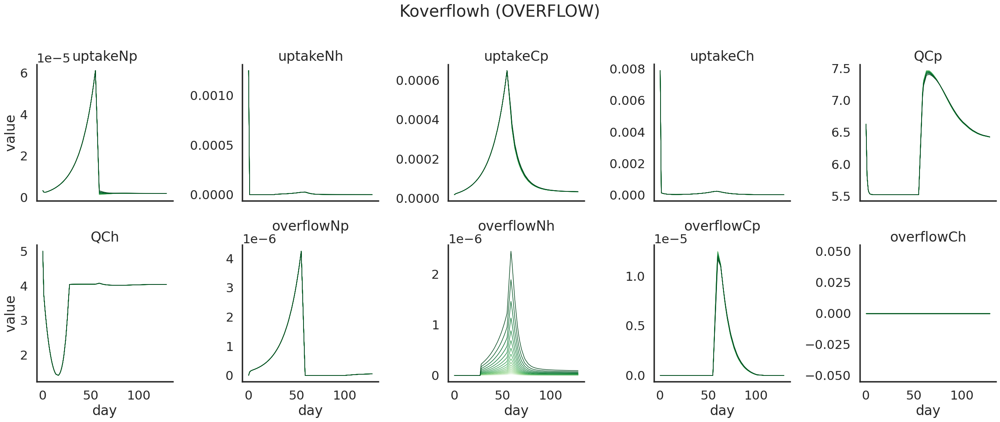

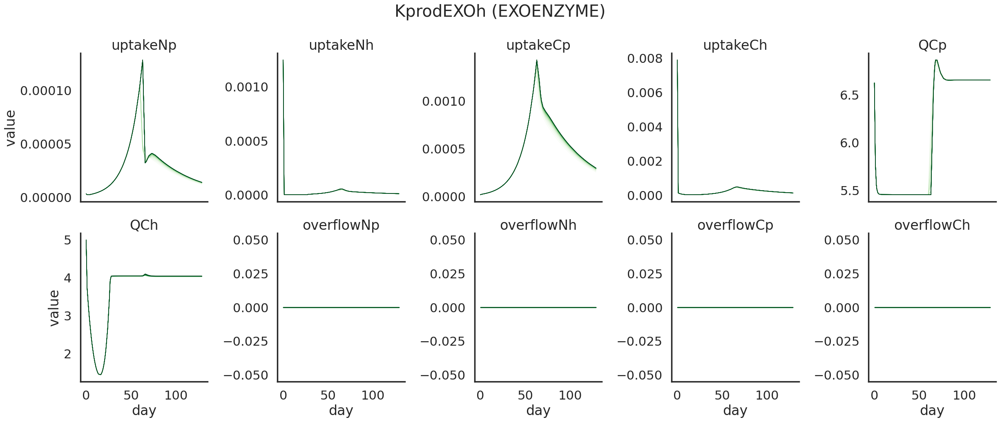

In [58]:
variables_to_track  = [
'uptakeNp','uptakeNh', 'uptakeCp', 'uptakeCh', 'QCp', 'QCh', 
 'overflowNp', 'overflowNh', 'overflowCp', 'overflowCh', 
]

import matplotlib.colors as colors
organism_to_tune = 'HET'
pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

for model in ['OVERFLOW', 'EXOENZYME']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
    curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
                    ~sdf.param.isin(pro_min_params_to_update) &
                    sdf['mode'].isin(['all'])
                   ]
    mcurdf = curdf.melt(
        id_vars=['run_id', 'day', 'param', 'paramval'],
        value_vars=variables_to_track,
        
    ).reset_index()

    for p in curdf.param.unique():
        
        g = sns.relplot(
            data=mcurdf.loc[mcurdf.param.isin([p])], x='day', y='value',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
            col='variable', lw=1, legend=False, palette='Greens',
            col_wrap=5,
            hue='paramval', 
            facet_kws=dict(sharey=False),
        ).set_titles(col_template='{col_name}')
        plt.suptitle(f'{p} ({model})', y=1.05)
        plt.show()


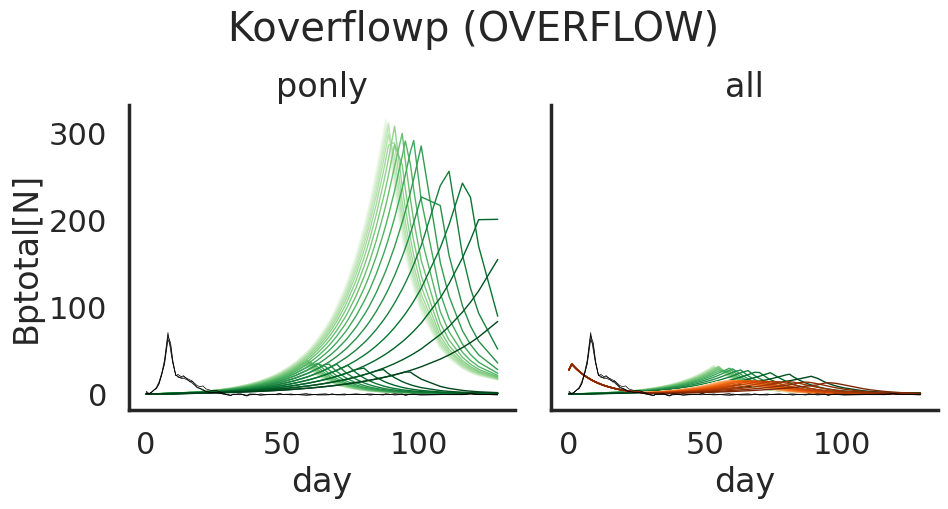

In [59]:

import matplotlib.colors as colors
organism_to_tune = 'PRO'
pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

for model in ['OVERFLOW', 'EXOENZYME']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
    curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
                    ~sdf.param.isin(pro_min_params_to_update) 
                    
                   ]
    for p in curdf.param.unique():
        
        g = sns.relplot(
            data=curdf.loc[curdf.param.isin([p])], x='day', y='Bptotal[N]',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
            col='mode', lw=1, legend=False, palette='Greens',
            col_order=['ponly', 'all'],
            hue='paramval', 
        )
        for col_val, ax in g.axes_dict.items():
            if col_val == 'all':
                sns.lineplot(
                    data=curdf.loc[curdf.param.isin([p]) & curdf['mode'].isin(['all'])], 
                    x='day', y='Bhtotal[N]',
                    units='run_id', estimator=None,
                     hue_norm=colors.LogNorm(),
                     lw=1, legend=False, palette='Oranges',
                    hue='paramval', 
                )
            datadf = refdf 
            sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
            units='Sample', estimator=None, ax=ax, lw=0.5, color='black',

                         legend=False
                        )
        g.set_titles(col_template='{col_name}')
        plt.suptitle(f'{p} ({model})', y=1.05)
        plt.show()


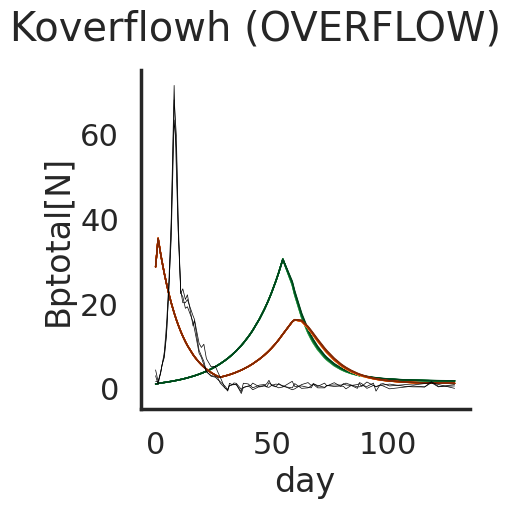

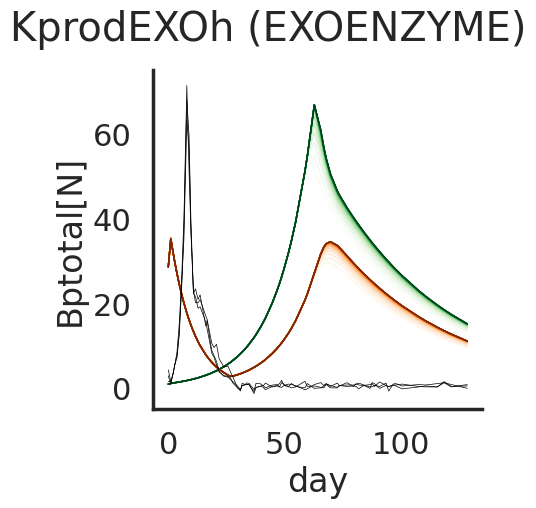

In [60]:

import matplotlib.colors as colors
organism_to_tune = 'HET'
pro_min_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values('MIN', organism_to_tune)

for model in ['OVERFLOW', 'EXOENZYME']: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    
    curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
                    ~sdf.param.isin(pro_min_params_to_update) &
                    sdf['mode'].isin(['all'])
                   ]
    for p in curdf.param.unique():
        
        g = sns.relplot(
            data=curdf.loc[curdf.param.isin([p])], x='day', y='Bptotal[N]',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
            #col='mode', 
            lw=1, legend=False, palette='Greens',
            #col_order=['ponly', 'all'],
            hue='paramval', 
        )
        #for col_val, ax in g.axes_dict.items():
        #    if col_val == 'all':
        sns.lineplot(
            data=curdf.loc[curdf.param.isin([p]) & curdf['mode'].isin(['all'])], 
            x='day', y='Bhtotal[N]',
            units='run_id', estimator=None,
             hue_norm=colors.LogNorm(),
             lw=1, legend=False, palette='Oranges',
            hue='paramval', 
        )
        datadf = refdf 
        sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
        units='Sample', estimator=None, lw=0.5, color='black',

                         legend=False
                        )
        g.set_titles(col_template='{col_name}')
        plt.suptitle(f'{p} ({model})', y=1.05)
        plt.show()


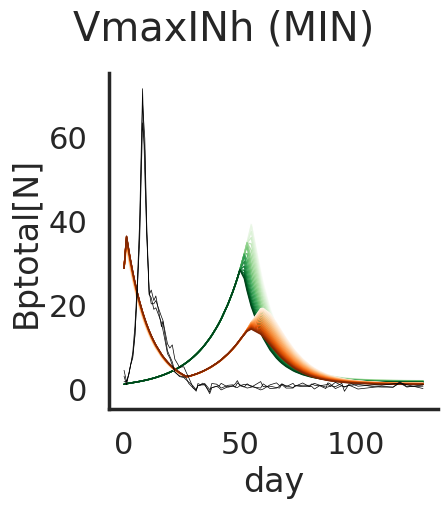

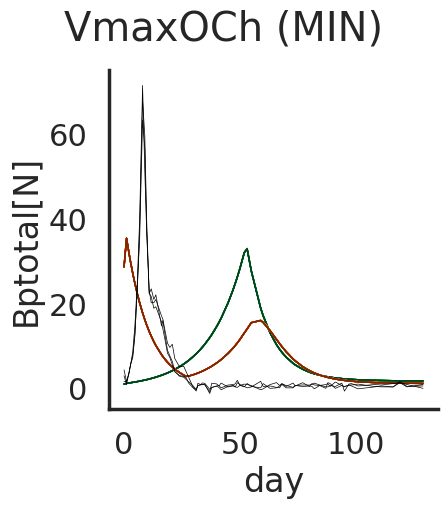

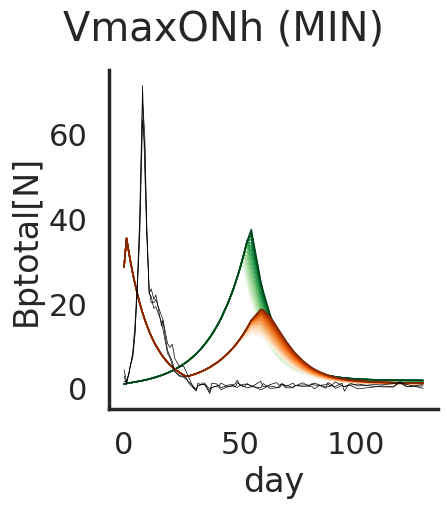

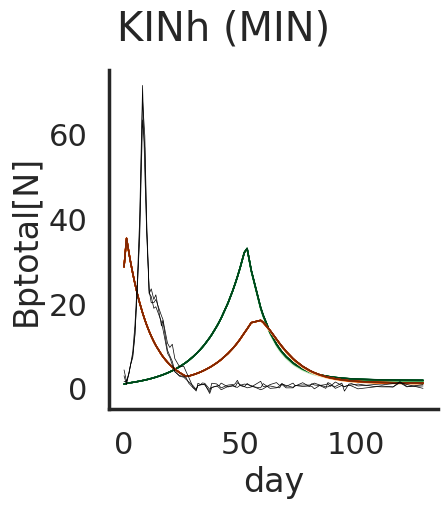

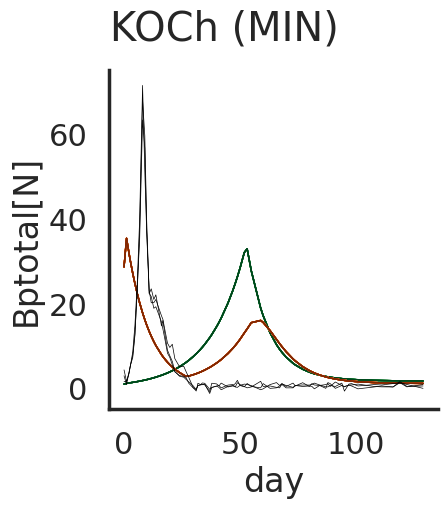

...

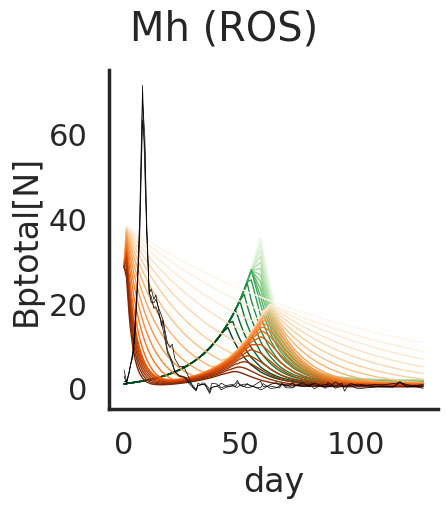

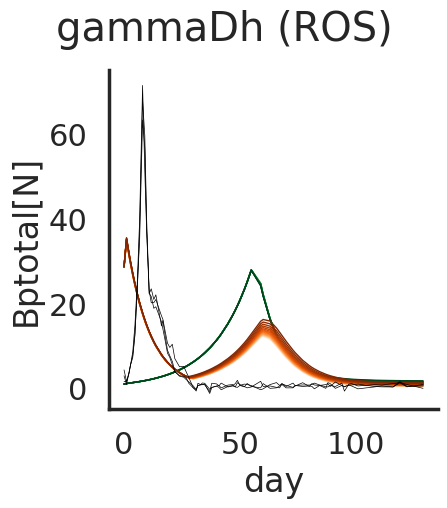

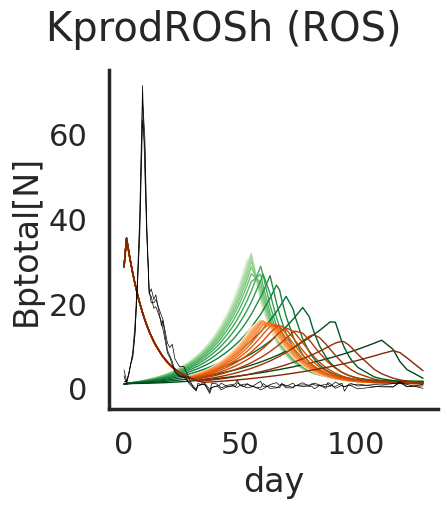

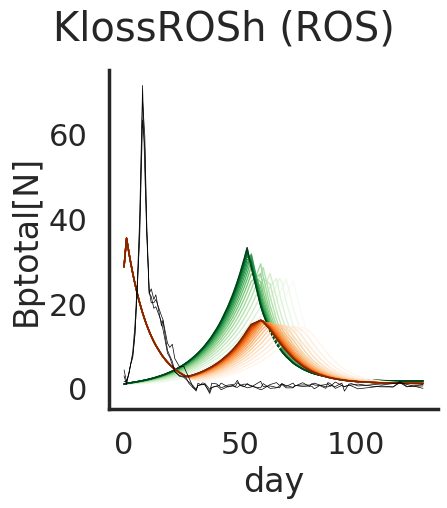

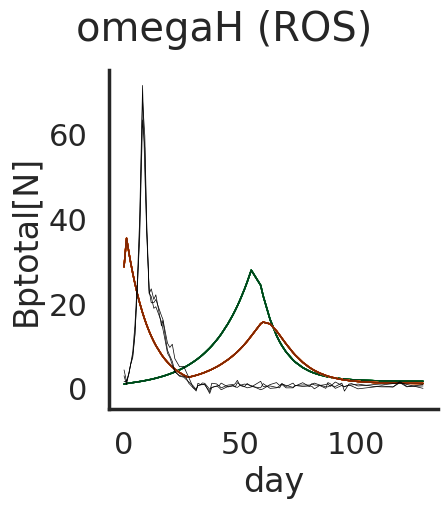

In [61]:

import matplotlib.colors as colors
organism_to_tune = 'HET'
for model in morder: 
    pro_params_to_update, pro_bounds, pro_log_params = get_param_tuning_values(model, organism_to_tune)

    curdf = sdf.loc[sdf.model.isin([model]) & sdf.param.isin(pro_params_to_update) &
                    sdf['mode'].isin(['all'])
                   ]
    for p in pro_params_to_update:
        
        g = sns.relplot(
            data=curdf.loc[curdf.param.isin([p])], x='day', y='Bptotal[N]',
            units='run_id', estimator=None,
             kind='line', hue_norm=colors.LogNorm(),
            lw=1, legend=False, palette='Greens',
            hue='paramval', 
        )
        sns.lineplot(
            data=curdf.loc[curdf.param.isin([p])], 
            x='day', y='Bhtotal[N]',
            units='run_id', estimator=None,
             hue_norm=colors.LogNorm(),
             lw=1, legend=False, palette='Oranges',
            hue='paramval', 
        )
        datadf = refdf 
        sns.lineplot(data=datadf, x='day', y='ref_Bp[N]',
        units='Sample', estimator=None, lw=0.5, color='black',

                     legend=False
                    )
        g.set_titles(col_template='{col_name}')
        plt.suptitle(f'{p} ({model})', y=1.05)
        plt.show()


In [62]:
sdf.describe()

,Bp,Np,Cp,DON,RDON,DIN,DOC,RDOC,DIC,ROS,...,respirationCh,biomass_breakdownCh,overflowNh,overflowCh,Bh[C],Bhtotal[N],Bhtotal[C],paramval,defaultval,paramfc
count,2.353200e+05,2.353200e+05,2.353200e+05,235320.000000,235320.000000,2.353200e+05,235320.000000,235320.000000,235320.000000,2.353200e+05,...,1.228400e+05,122840.000000,1.228400e+05,122840.0,1.228400e+05,122840.000000,1.228400e+05,2.353200e+05,2.353200e+05,235320.000000
mean,2.351231e+01,2.727964e+00,1.749291e+01,50.687853,31.802159,1.719683e+02,205.577770,181.830999,2157.080143,1.540892e-01,...,7.136114e-05,0.000010,6.240290e-09,0.0,3.411851e+01,10.353307,3.427893e+01,8.117578e+00,3.602461e+00,-0.177992
std,6.319173e+01,9.328424e+00,6.163233e+01,95.526013,68.222809,2.743279e+02,737.723454,451.325595,272.370728,8.302834e-02,...,7.259126e-05,0.000029,3.464990e-08,0.0,3.475130e+01,9.235797,3.486130e+01,4.018747e+01,1.078217e+01,1.972517
min,-2.384316e-11,-8.704519e-12,-1.663662e-13,0.008324,0.000000,1.605247e-09,0.000145,0.000000,2.778662,6.253364e-15,...,2.314057e-15,0.000000,0.000000e+00,0.0,1.110748e-09,0.000101,1.110748e-09,4.696017e-10,4.696017e-09,-3.321928
25%,1.423030e+00,6.663127e-02,4.408270e-01,4.034863,2.219126,3.783125e-03,0.004597,10.431851,2180.438852,2.000000e-01,...,2.025930e-05,0.000000,0.000000e+00,0.0,9.650171e+00,3.181830,9.736632e+00,3.030886e-06,5.555556e-06,-1.923222
50%,4.393397e+00,4.233755e-01,2.005539e+00,25.015193,10.084697,8.206589e+01,0.012452,38.494806,2233.602072,2.000000e-01,...,4.243178e-05,0.000000,0.000000e+00,0.0,2.018658e+01,7.314223,2.040161e+01,7.525586e-05,6.666667e-05,-0.330589
75%,1.748190e+01,1.675845e+00,8.030796e+00,56.365236,33.762369,9.975191e+01,36.332946,164.666789,2245.004308,2.000000e-01,...,1.002494e-04,0.000000,0.000000e+00,0.0,4.787210e+01,14.924657,4.816411e+01,1.414718e-01,1.000000e-01,1.573545
max,7.790810e+02,2.214701e+02,9.763520e+02,700.422431,802.588888,8.007679e+02,16996.187251,6052.782000,2324.613512,2.000000e-01,...,4.472494e-04,0.000262,2.453492e-06,0.0,2.134410e+02,52.328471,2.149152e+02,3.700000e+02,3.700000e+01,3.321928


In [63]:
bounds

NameError: name 'bounds' is not defined

In [ ]:
init_var_vals

In [ ]:
1.98750000e+01

In [64]:
param_vals

{'VmaxICp': 5.555555555555556e-06,
 'VmaxICh': 0.0,
 'VmaxINp': 5.555555555555556e-06,
 'VmaxINh': 6.666666666666667e-05,
 'VmaxOCp': 1.8518518518518519e-06,
 'VmaxOCh': 6.666666666666667e-05,
 'VmaxONp': 1.1111111111111112e-06,
 'VmaxONh': 6.666666666666667e-05,
 'KICp': 37.0,
 'KICh': 1.0,
 'KINp': 0.02,
 'KINh': 0.02,
 'KOCp': 0.03,
 'KOCh': 0.1,
 'KONp': 0.1,
 'KONh': 0.1,
 'Mp': 1.157407407407407e-06,
 'Mh': 1.157407407407407e-06,
 'gammaDp': 0.8,
 'gammaDh': 0.8,
 'Rp': 6.625,
 'Rh': 5.0,
 'QCmaxp': 10.0,
 'QCminp': 4.0,
 'QCmaxh': 10.0,
 'QCminh': 4.0,
 'Kmtbp': 3.5e-05,
 'Kmtbh': 0.00017499999999999997,
 'bp': 0.01,
 'bh': 0.01,
 'r0p': 2.083333333333333e-06,
 'r0h': 2.083333333333333e-06,
 'KdecayDON': 2.31481481481482e-08,
 'KprodEXOp': 0.0,
 'KprodEXOh': 1.15740740740741e-06,
 'OverflowMode': 1.0,
 'Koverflowp': 1.157407407407407e-06,
 'Koverflowh': 1.157407407407407e-06,
 'ROSMode': 1.0,
 'KprodROSp': 4.696016771488469e-09,
 'KprodROSh': 1.9444444444444442e-08,
 'KlossROSp'